# Engine Prognosis Modelling

### NASA Code Repository
https://ti.arc.nasa.gov/tech/dash/groups/pcoe/prognostic-data-repository/

Data Set: FD001
Train trjectories: 100
Test trajectories: 100
Conditions: ONE (Sea Level)
Fault Modes: ONE (HPC Degradation)

Data Set: FD002
Train trjectories: 260
Test trajectories: 259
Conditions: SIX 
Fault Modes: ONE (HPC Degradation)

Data Set: FD003
Train trjectories: 100
Test trajectories: 100
Conditions: ONE (Sea Level)
Fault Modes: TWO (HPC Degradation, Fan Degradation)

Data Set: FD004
Train trjectories: 248
Test trajectories: 249
Conditions: SIX 
Fault Modes: TWO (HPC Degradation, Fan Degradation)


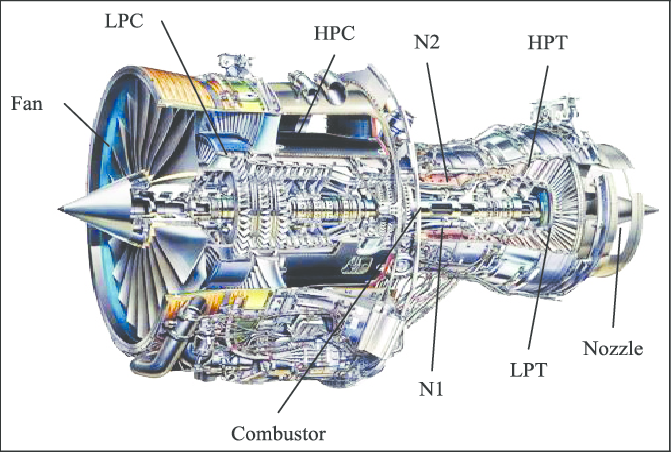

In [1]:
from IPython.display import Image
Image("/home/dsc/Downloads/turbofan.png")

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

Let's import the dataset containing the training database of the 1st round of unit engines.

In [3]:
df_train_1 = pd.read_csv('/home/dsc/Downloads/CMAPSSData/train_FD001.txt', sep=" ", header=None)

In [4]:
df_train_1.head()

,0,1,2,3,4,5,6,7,8,9,...,18,19,20,21,22,23,24,25,26,27
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190,NaN,NaN
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236,NaN,NaN
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442,NaN,NaN
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739,NaN,NaN
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044,NaN,NaN


As we see, column names are not included, they are referenced as numbers. Helped by available bibliography we know the real names so we proceed to change them.
- First column is "ID" and it refers to the engine unit
- Second column is "Cycle" and it counts the cycle number where the engine is representing the data
- The next 3 columns are the "Operational Settings" and they refer to the flight conditions variation which affect the flight performance
- The last 23 columns refer the "Sensor Measurement" and show the value of the different physical conditions happening inside the engine during the flight cycle

In [5]:
df_train_1.columns

Int64Index([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
            17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27],
           dtype='int64')

In [6]:
list_units_1 = 3
operational_list = []
for n in range(1,list_units_1+1):
    operational = "operarional_setting_" + str(n)
    operational_list.append(operational)
 

In [7]:
list_units_2 = 23
sensor_measurement_list = []
for n in range(1,list_units_2+1):
    sensor = "sensor_measurement_" + str(n)
    sensor_measurement_list.append(sensor)
 

In [8]:
df_train_1.columns = ["ID", "Cycle"] + operational_list + sensor_measurement_list

In [9]:
df_train_1

,ID,Cycle,operarional_setting_1,operarional_setting_2,operarional_setting_3,sensor_measurement_1,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_5,...,sensor_measurement_14,sensor_measurement_15,sensor_measurement_16,sensor_measurement_17,sensor_measurement_18,sensor_measurement_19,sensor_measurement_20,sensor_measurement_21,sensor_measurement_22,sensor_measurement_23
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190,NaN,NaN
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236,NaN,NaN
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442,NaN,NaN
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739,NaN,NaN
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,100,196,-0.0004,-0.0003,100.0,518.67,643.49,1597.98,1428.63,14.62,...,8137.60,8.4956,0.03,397,2388,100.0,38.49,22.9735,NaN,NaN
20627,100,197,-0.0016,-0.0005,100.0,518.67,643.54,1604.50,1433.58,14.62,...,8136.50,8.5139,0.03,395,2388,100.0,38.30,23.1594,NaN,NaN
20628,100,198,0.0004,0.0000,100.0,518.67,643.42,1602.46,1428.18,14.62,...,8141.05,8.5646,0.03,398,2388,100.0,38.44,22.9333,NaN,NaN
20629,100,199,-0.0011,0.0003,100.0,518.67,643.23,1605.26,1426.53,14.62,...,8139.29,8.5389,0.03,395,2388,100.0,38.29,23.0640,NaN,NaN


With a very brief check of the dataset we detect two columns with many NaNs (last two)

In [10]:
df_train_1.isnull().sum()

ID                           0
Cycle                        0
operarional_setting_1        0
operarional_setting_2        0
operarional_setting_3        0
sensor_measurement_1         0
sensor_measurement_2         0
sensor_measurement_3         0
sensor_measurement_4         0
sensor_measurement_5         0
sensor_measurement_6         0
sensor_measurement_7         0
sensor_measurement_8         0
sensor_measurement_9         0
sensor_measurement_10        0
sensor_measurement_11        0
sensor_measurement_12        0
sensor_measurement_13        0
sensor_measurement_14        0
sensor_measurement_15        0
sensor_measurement_16        0
sensor_measurement_17        0
sensor_measurement_18        0
sensor_measurement_19        0
sensor_measurement_20        0
sensor_measurement_21        0
sensor_measurement_22    20631
sensor_measurement_23    20631
dtype: int64

In [11]:
df_train_1[["sensor_measurement_22","sensor_measurement_23"]].value_counts()

Series([], dtype: int64)

In [12]:
df_train_1["sensor_measurement_22"].nunique

<bound method IndexOpsMixin.nunique of 0       NaN
1       NaN
2       NaN
3       NaN
4       NaN
         ..
20626   NaN
20627   NaN
20628   NaN
20629   NaN
20630   NaN
Name: sensor_measurement_22, Length: 20631, dtype: float64>

We hence confirme the last two columns of sensor measurement are entirely NaN values, so we can discard them

In [13]:
df_train_1 = df_train_1.dropna(axis=1)
df_train_1.head()

,ID,Cycle,operarional_setting_1,operarional_setting_2,operarional_setting_3,sensor_measurement_1,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_5,...,sensor_measurement_12,sensor_measurement_13,sensor_measurement_14,sensor_measurement_15,sensor_measurement_16,sensor_measurement_17,sensor_measurement_18,sensor_measurement_19,sensor_measurement_20,sensor_measurement_21
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044


Let's have a quick view of these variables evolution for a specific engine, and dropping the value of "Cycle" which we already know it will go invariably upwards

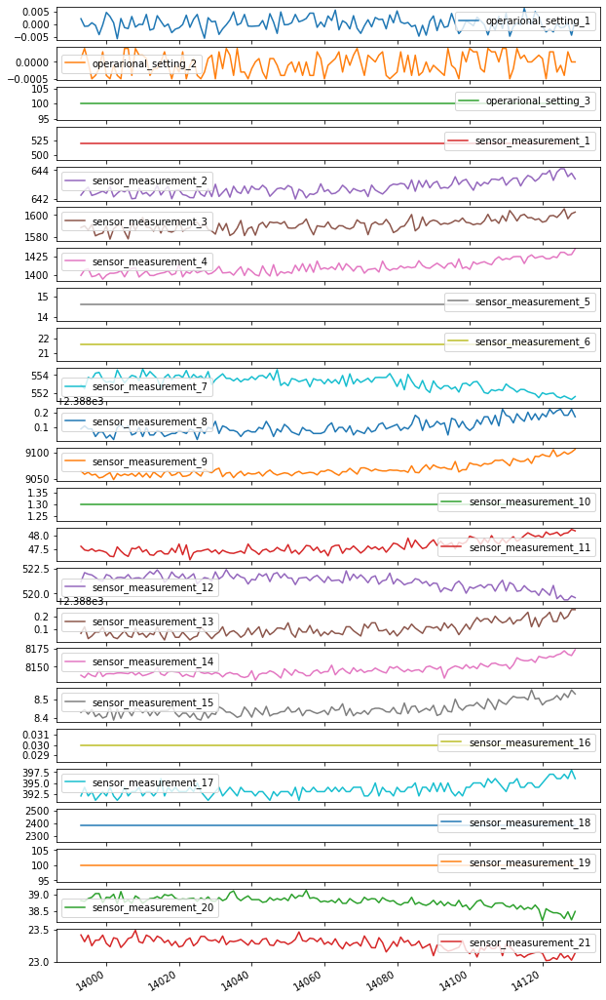

In [14]:
df_train_1[df_train_1.ID == 70].drop(columns=["ID","Cycle"]).plot(subplots =True, figsize = (10,20));

[1] The variable which will provide the information of the current engine health is the Remaining Useful Life (RUL) which will be different for each engine unit and will decrease after each cycle performed.

This variable represents the number of cycles remaining until the end of life of the engine

In order to calculate we first need to determine the maximum number of cycles achieved by each unit, and then compute a decrease

In [15]:
max_cycle_dataset_1 = df_train_1.groupby(["ID"])["Cycle"].max().reset_index()
max_cycle_dataset_1 = max_cycle_dataset_1.rename(columns={"Cycle":"Max_cycle"})

In [16]:
max_cycle_dataset_1

,ID,Max_cycle
0,1,192
1,2,287
2,3,179
3,4,189
4,5,269
...,...,...
95,96,336
96,97,202
97,98,156
98,99,185


We have determined now the maximum number of cycles per engine unit, and also the total number of engines contained in this dataset, 100 units

In [17]:
df_train_1 = df_train_1.merge(max_cycle_dataset_1, how="inner", on="ID")
df_train_1["RUL"] = df_train_1["Max_cycle"] - df_train_1["Cycle"]
df_train_1
# df_train_1 = df_train_1.drop(["Max_cycle"],axis=1)
# df_train_1.head()

,ID,Cycle,operarional_setting_1,operarional_setting_2,operarional_setting_3,sensor_measurement_1,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_5,...,sensor_measurement_14,sensor_measurement_15,sensor_measurement_16,sensor_measurement_17,sensor_measurement_18,sensor_measurement_19,sensor_measurement_20,sensor_measurement_21,Max_cycle,RUL
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190,192,191
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236,192,190
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442,192,189
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739,192,188
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044,192,187
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,100,196,-0.0004,-0.0003,100.0,518.67,643.49,1597.98,1428.63,14.62,...,8137.60,8.4956,0.03,397,2388,100.0,38.49,22.9735,200,4
20627,100,197,-0.0016,-0.0005,100.0,518.67,643.54,1604.50,1433.58,14.62,...,8136.50,8.5139,0.03,395,2388,100.0,38.30,23.1594,200,3
20628,100,198,0.0004,0.0000,100.0,518.67,643.42,1602.46,1428.18,14.62,...,8141.05,8.5646,0.03,398,2388,100.0,38.44,22.9333,200,2
20629,100,199,-0.0011,0.0003,100.0,518.67,643.23,1605.26,1426.53,14.62,...,8139.29,8.5389,0.03,395,2388,100.0,38.29,23.0640,200,1


In [19]:
sensor_columns = df_train_1.columns[5:-2]

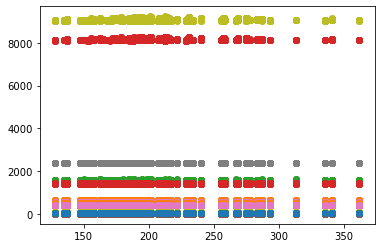

In [20]:
for x in sensor_columns:
    x = df_train_1[x]
    y = df_train_1["Max_cycle"]
    plt.scatter(y,x)

#### Let's have a check of the preliminary dataset to work with

/home/dsc/anaconda3/lib/python3.8/site-packages/pandas/plotting/_matplotlib/core.py:328: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


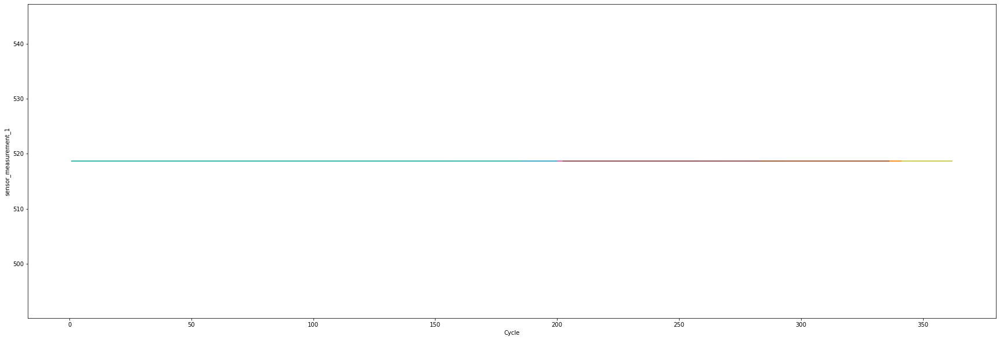

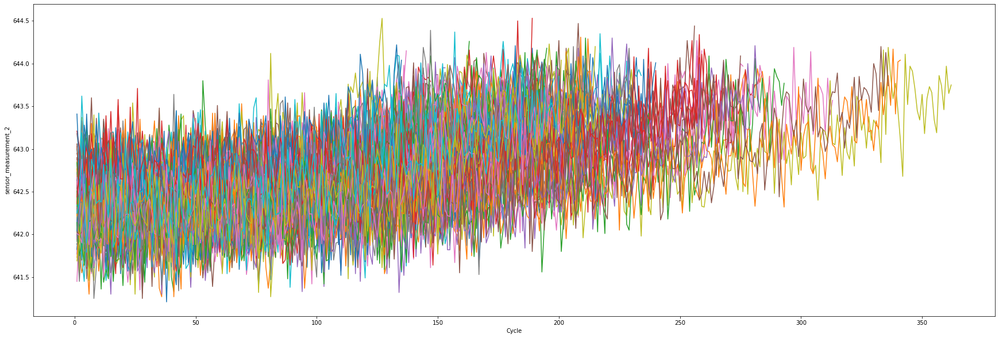

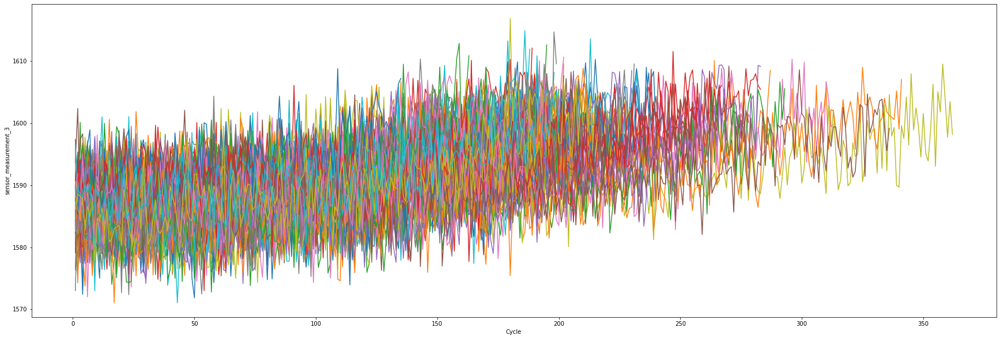

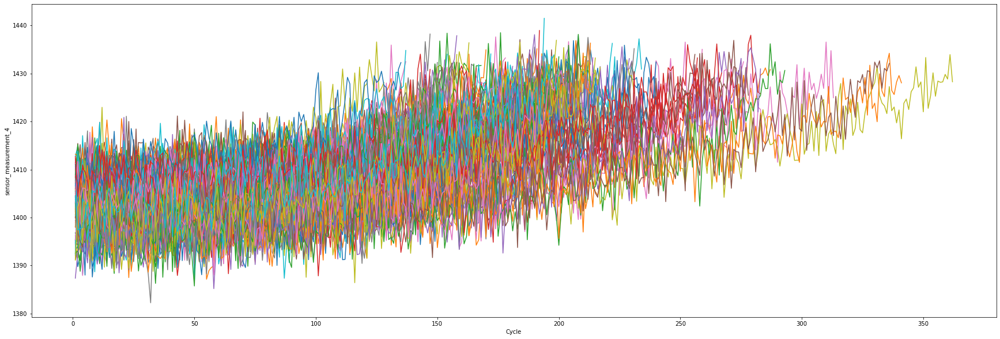

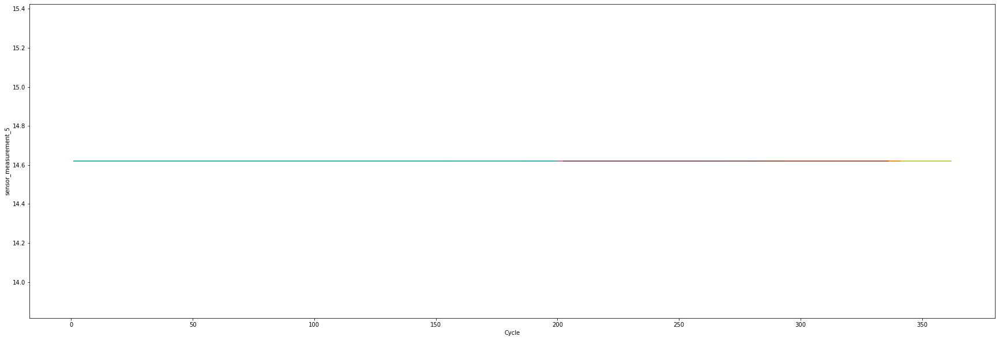

...

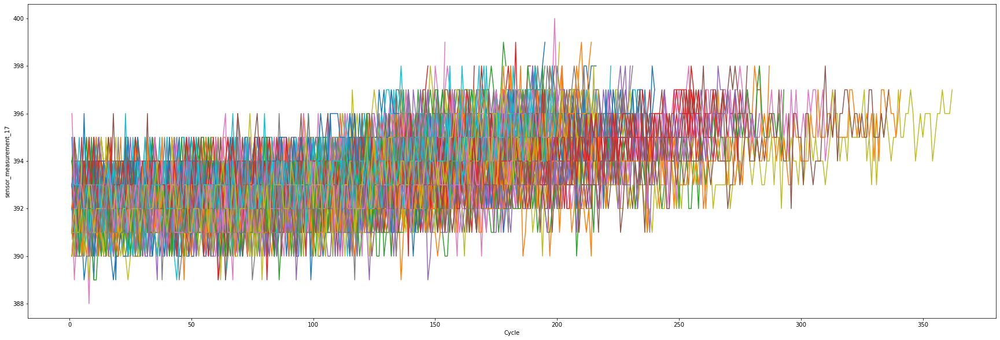

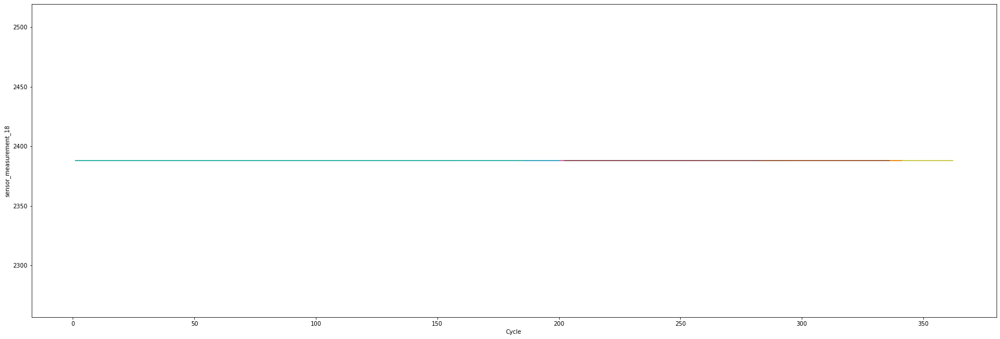

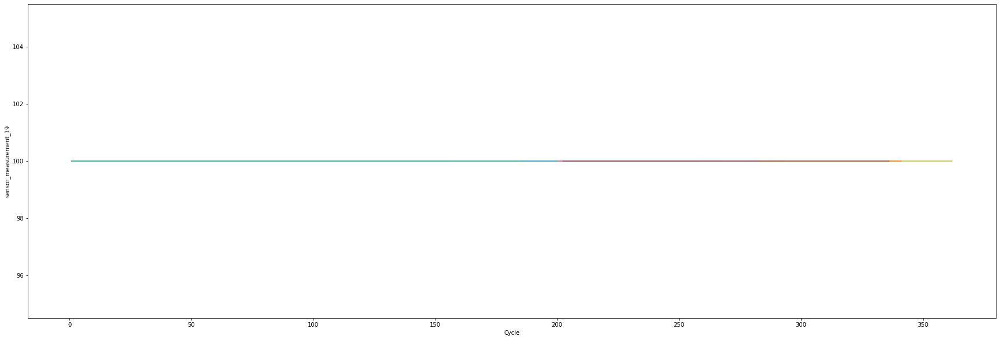

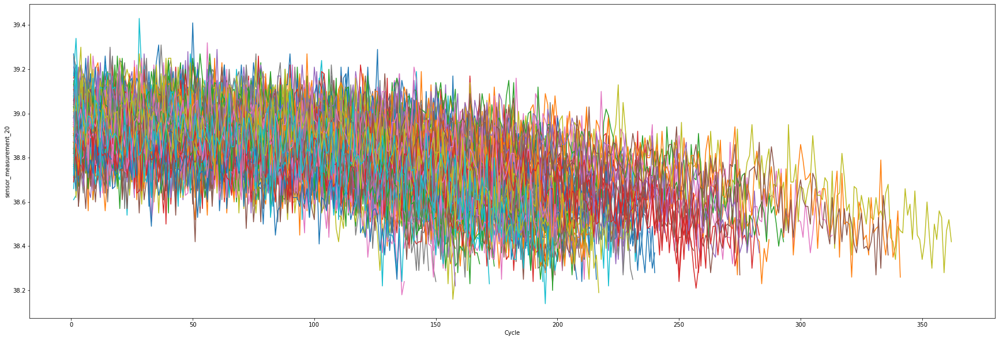

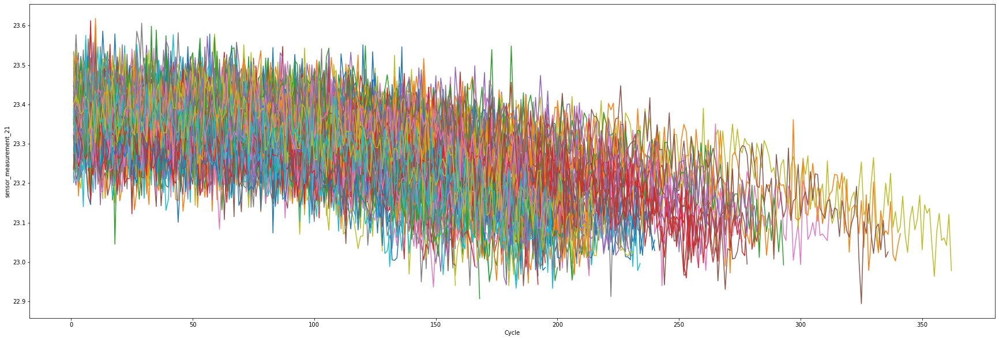

In [21]:
sensor_columns = df_train_1.columns[5:-2].tolist()
for col in sensor_columns:
    
    df = df_train_1[["ID","Cycle",col]].pivot(index="Cycle", columns="ID", values=col)
    df.plot(figsize=(30,10), legend=None)
    plt.ylabel(str(col))

In [18]:
df_train_1.shape

(20631, 27)

The overal dataset comprises 27 diferent variables (26 independent and 1 dependent) and 20631 rows comprising feature values and cycles.

Top 10 max cycles engines from list:

In [19]:
df_train_1[["ID","Cycle"]].groupby("ID").max(["Cycle"]).sort_values(by='Cycle', ascending=False).head(10)

,Cycle
ID,
69,362
92,341
96,336
67,313
83,293
2,287
95,283
64,283
86,278


Average max cycles through engines

Average value for max cycles reached by engines:  206.31


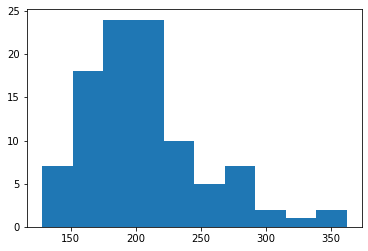

In [20]:
max_cycle_dataset_1 = df_train_1.groupby(["ID"])["Cycle"].max().reset_index()
max_cycle_dataset_1 = max_cycle_dataset_1.rename(columns={"Cycle":"Max_cycle"})
plt.hist(max_cycle_dataset_1["Max_cycle"])
print("Average value for max cycles reached by engines: ", max_cycle_dataset_1["Max_cycle"].mean())

Let's now have a check in the dependant variable, the RUL

Text(0, 0.5, 'Max Cycle')

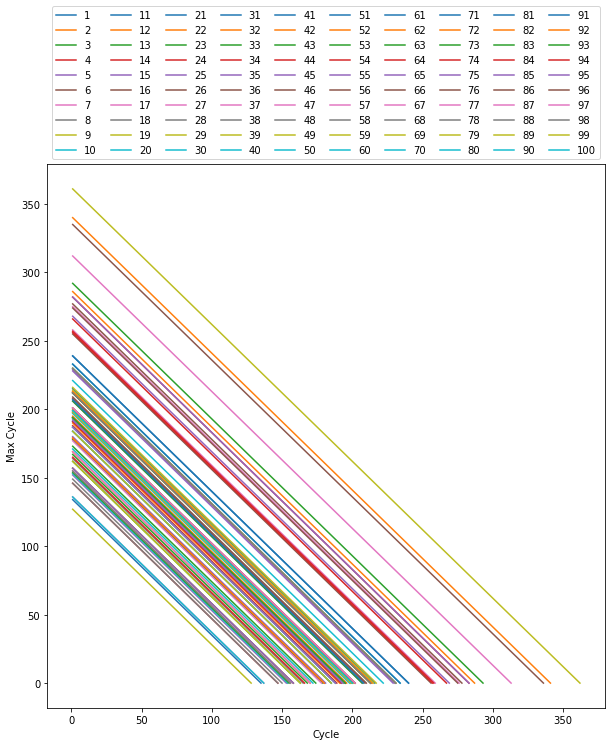

In [21]:
df_RUL_engine_1 = df_train_1[["ID","Cycle","RUL"]]
df_RUL_engine_1 = df_RUL_engine_1.pivot(index='Cycle', columns='ID', values='RUL')

df_RUL_engine_1.plot(figsize=(10, 10))
plt.legend(bbox_to_anchor=(0,1,1,1), loc=3,
       ncol=10, mode="expand")
plt.ylabel("Max Cycle")

We have above a representation of how the engine life for each engine decreases from the cycle 0, where the RUL is maximum, until it reaches RUL = 0 at maximum cycle

#### Let's have a look at the operational settings

In [22]:
df_1_opst_1 = df_train_1[["ID","Cycle","operarional_setting_1"]]
df_1_opst_2 = df_train_1[["ID","Cycle","operarional_setting_2"]]
df_1_opst_3 = df_train_1[["ID","Cycle","operarional_setting_3"]]

df_1_opst_1 = df_1_opst_1.pivot(index='Cycle', columns='ID', values='operarional_setting_1')
df_1_opst_2 = df_1_opst_2.pivot(index='Cycle', columns='ID', values='operarional_setting_2')
df_1_opst_3 = df_1_opst_3.pivot(index='Cycle', columns='ID', values='operarional_setting_3')

Operational setting 1 behavior during cycle evolution per engine unit

Maximum value for operational setting 1:  0.0087 
 Minimum value for operational setting 1:  -0.0087 
 Average value for operational setting 1:  -8.870146866366216e-06


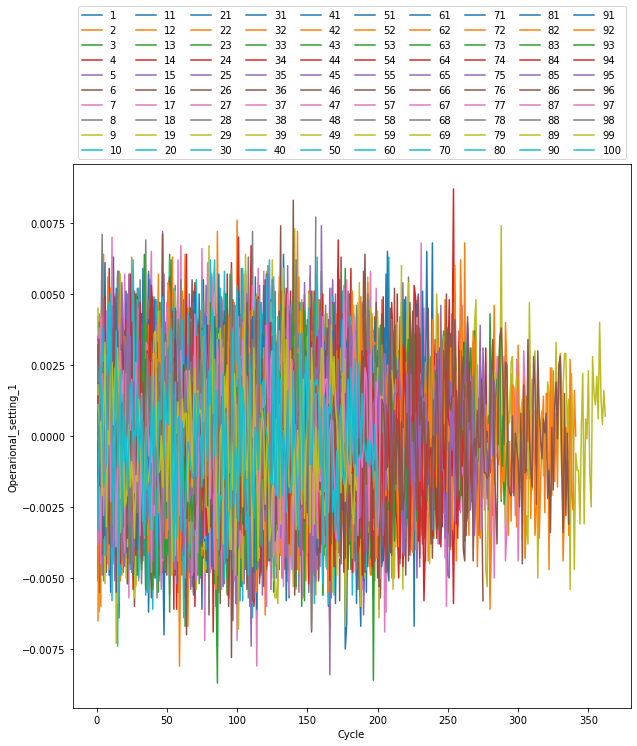

In [23]:
df_1_opst_1.plot(figsize=(10, 10))
plt.legend(bbox_to_anchor=(0,1,1,1), loc=3,
       ncol=10, mode="expand")
plt.ylabel("Operarional_setting_1")

print("Maximum value for operational setting 1: ", df_train_1["operarional_setting_1"].max(),"\n",
     "Minimum value for operational setting 1: " , df_train_1["operarional_setting_1"].min(),"\n",
     "Average value for operational setting 1: " , df_train_1["operarional_setting_1"].mean())

Operational setting 2 behavior during cycle evolution per engine unit

Maximum value for operational setting 2:  0.0006 
 Minimum value for operational setting 2:  -0.0006 
 Average value for operational setting 2:  2.350831273326574e-06


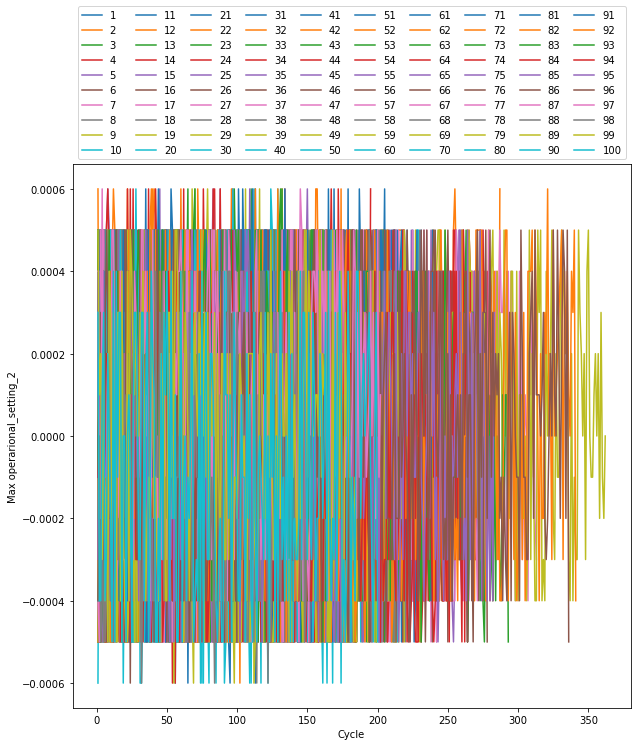

In [24]:
df_1_opst_2.plot(figsize=(10, 10))
plt.legend(bbox_to_anchor=(0,1,1,1), loc=3,
       ncol=10, mode="expand")
plt.ylabel("Max operarional_setting_2")

print("Maximum value for operational setting 2: ", df_train_1["operarional_setting_2"].max(),"\n",
     "Minimum value for operational setting 2: " , df_train_1["operarional_setting_2"].min(),"\n",
     "Average value for operational setting 2: " , df_train_1["operarional_setting_2"].mean())

Operational setting 3 behavior during cycle evolution per engine unit

Maximum value for operational setting 3:  100.0 
 Minimum value for operational setting 3:  100.0 
 Average value for operational setting 3:  100.0


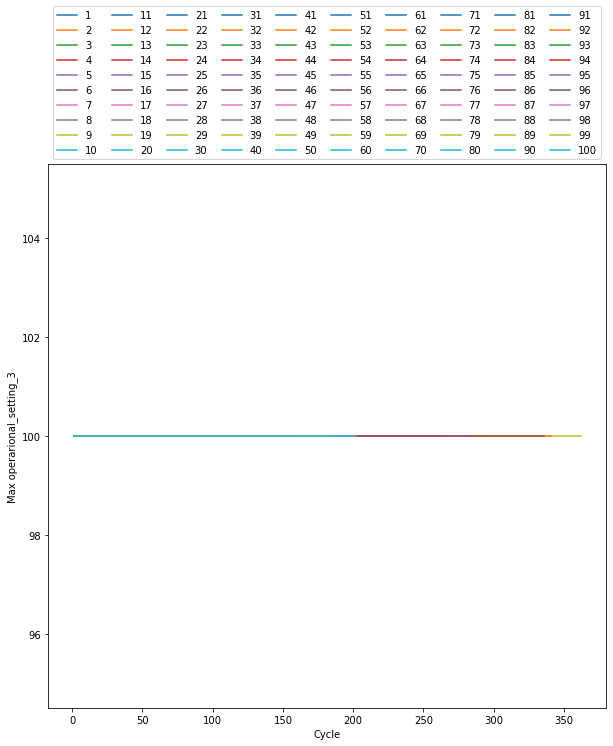

In [25]:
df_1_opst_3.plot(figsize=(10, 10))
plt.legend(bbox_to_anchor=(0,1,1,1), loc=3,
       ncol=10, mode="expand")
plt.ylabel("Max operarional_setting_3")

print("Maximum value for operational setting 3: ", df_train_1["operarional_setting_3"].max(),"\n",
     "Minimum value for operational setting 3: " , df_train_1["operarional_setting_3"].min(),"\n",
     "Average value for operational setting 3: " , df_train_1["operarional_setting_3"].mean())

In [26]:
df_train_1.groupby("ID")["operarional_setting_3"].std().value_counts()

0.0    100
Name: operarional_setting_3, dtype: int64

Operational setting seems to have no changes, so we can discard it from the dataset

In [27]:
df_train_1.drop(columns="operarional_setting_3",axis=1, inplace=True)
df_train_1

,ID,Cycle,operarional_setting_1,operarional_setting_2,sensor_measurement_1,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_5,sensor_measurement_6,...,sensor_measurement_13,sensor_measurement_14,sensor_measurement_15,sensor_measurement_16,sensor_measurement_17,sensor_measurement_18,sensor_measurement_19,sensor_measurement_20,sensor_measurement_21,RUL
0,1,1,-0.0007,-0.0004,518.67,641.82,1589.70,1400.60,14.62,21.61,...,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190,191
1,1,2,0.0019,-0.0003,518.67,642.15,1591.82,1403.14,14.62,21.61,...,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236,190
2,1,3,-0.0043,0.0003,518.67,642.35,1587.99,1404.20,14.62,21.61,...,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442,189
3,1,4,0.0007,0.0000,518.67,642.35,1582.79,1401.87,14.62,21.61,...,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739,188
4,1,5,-0.0019,-0.0002,518.67,642.37,1582.85,1406.22,14.62,21.61,...,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044,187
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,100,196,-0.0004,-0.0003,518.67,643.49,1597.98,1428.63,14.62,21.61,...,2388.26,8137.60,8.4956,0.03,397,2388,100.0,38.49,22.9735,4
20627,100,197,-0.0016,-0.0005,518.67,643.54,1604.50,1433.58,14.62,21.61,...,2388.22,8136.50,8.5139,0.03,395,2388,100.0,38.30,23.1594,3
20628,100,198,0.0004,0.0000,518.67,643.42,1602.46,1428.18,14.62,21.61,...,2388.24,8141.05,8.5646,0.03,398,2388,100.0,38.44,22.9333,2
20629,100,199,-0.0011,0.0003,518.67,643.23,1605.26,1426.53,14.62,21.61,...,2388.23,8139.29,8.5389,0.03,395,2388,100.0,38.29,23.0640,1


Let's analyze deeply the operational settings 1 and 2:

In [28]:
import seaborn as sns

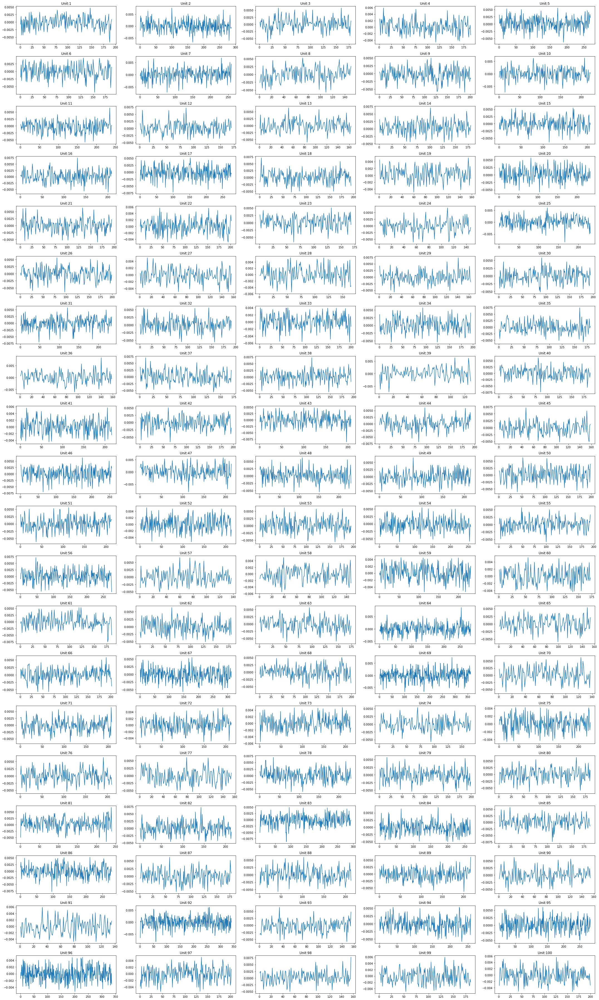

In [29]:
fig, ax = plt.subplots(nrows = 20, ncols = 5, figsize = (30,50))

ax = ax.ravel()

for i in range(0,100):
    sns.lineplot(data = df_train_1[df_train_1.ID == i+1], x = "Cycle", y = "operarional_setting_1", ax = ax[i])
    ax[i].set_title("Unit:" + str(i+1))
    ax[i].set_xlabel("")
    ax[i].set_ylabel("")

plt.tight_layout()

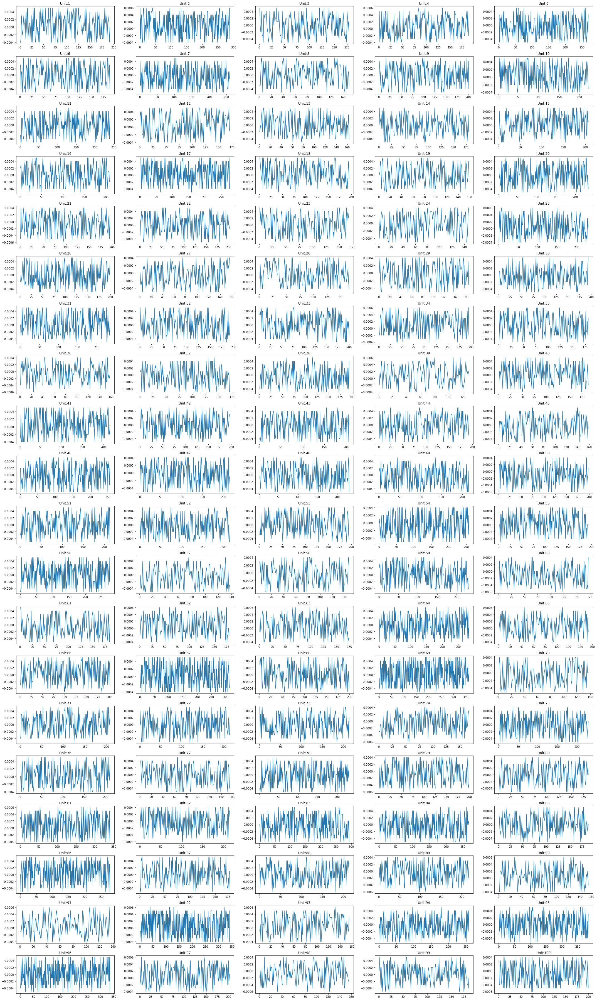

In [30]:
fig, ax = plt.subplots(nrows = 20, ncols = 5, figsize = (30,50))

ax = ax.ravel()

for i in range(0,100):
    sns.lineplot(data = df_train_1[df_train_1.ID == i+1], x = "Cycle", y = "operarional_setting_2", ax = ax[i])
    ax[i].set_title("Unit:" + str(i+1))
    ax[i].set_xlabel("")
    ax[i].set_ylabel("")

plt.tight_layout()

### Let's check the Sensor Measurements

Write the unit engine number to get the sensor measurements: 14


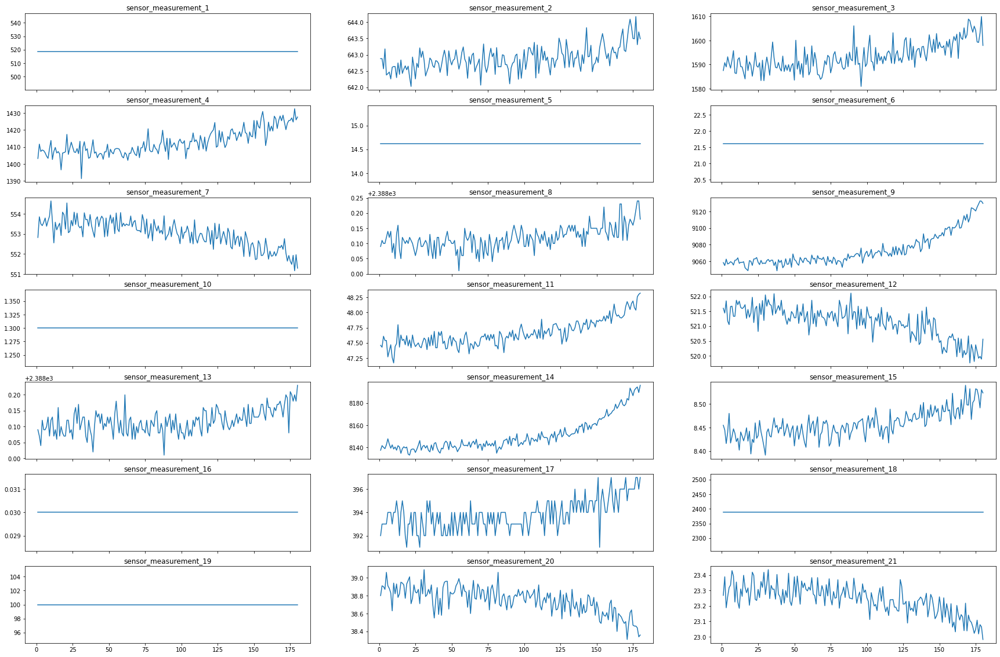

In [31]:
fig,ax=plt.subplots(7,3,figsize=(30,20),sharex=True)

unit = input("Write the unit engine number to get the sensor measurements: ")
df_unit = df_train_1.query("ID==@unit")

contador = 0
for i in range(0,7):
    for j in range(0,3):
        ax[i,j].plot(df_unit["Cycle"], df_unit['sensor_measurement_'+str(contador+1)])
        ax[i,j].set_title('sensor_measurement_'+str(contador+1))
        contador+=1
        
plt.show()

We see there are some sensors which do not reflect any change during the cycles, so we proceed to list them

In [32]:
unit = input("Write the unit engine number to list the sensor measurements: ")
df_unit_n = df_train_1.query("ID==@unit")
filter_col = [col for col in df_train_1 if col.startswith('sensor_measurement_')]
df_unit_n_chosen = df_unit_n[filter_col]

df_unit_n_chosen["Cycle"] = df_unit_n["Cycle"]

df_std = df_unit_n_chosen[df_unit_n_chosen.columns[df_unit_n_chosen.std(axis=0) < 1e-10]]
df_std_list = df_std.columns
print(df_std_list,
     len(df_std_list))

Write the unit engine number to list the sensor measurements: 11
Index(['sensor_measurement_1', 'sensor_measurement_5', 'sensor_measurement_10',
       'sensor_measurement_16', 'sensor_measurement_18',
       'sensor_measurement_19'],
      dtype='object') 6


<ipython-input-32-f9fe64f13c8a>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_unit_n_chosen["Cycle"] = df_unit_n["Cycle"]


As we have checked, there are some units (entered manually) which some sensor measurements have no variation, hence, we have to investigate if this is something general and discard the variables which do not provide any useful information

In [33]:
print("sensor 1: ", df_train_1["sensor_measurement_1"].value_counts(), "\n",
        "sensor 5: ", df_train_1["sensor_measurement_5"].value_counts(), "\n",
        "sensor 10: ", df_train_1["sensor_measurement_10"].value_counts(), "\n",
        "sensor 16: ", df_train_1["sensor_measurement_16"].value_counts(), "\n",
        "sensor 18: ", df_train_1["sensor_measurement_18"].value_counts(), "\n",
        "sensor 18: ", df_train_1["sensor_measurement_19"].value_counts())

sensor 1:  518.67    20631
Name: sensor_measurement_1, dtype: int64 
 sensor 5:  14.62    20631
Name: sensor_measurement_5, dtype: int64 
 sensor 10:  1.3    20631
Name: sensor_measurement_10, dtype: int64 
 sensor 16:  0.03    20631
Name: sensor_measurement_16, dtype: int64 
 sensor 18:  2388    20631
Name: sensor_measurement_18, dtype: int64 
 sensor 18:  100.0    20631
Name: sensor_measurement_19, dtype: int64


In [34]:
list_units_2 = 21
sensor_measurement_list = []
for n in range(1,list_units_2+1):
    sensor = "sensor_measurement_" + str(n)
    sensor_measurement_list.append(sensor)
    
df_std = df_train_1.groupby(["ID"])[sensor_measurement_list].std()
columns_to_delete = []
for col in df_std:
    if df_std[col].mean()<1e-3:
        columns_to_delete.append(col)
print(columns_to_delete)

['sensor_measurement_1', 'sensor_measurement_5', 'sensor_measurement_6', 'sensor_measurement_10', 'sensor_measurement_16', 'sensor_measurement_18', 'sensor_measurement_19']


In [35]:
df_train_1["sensor_measurement_6"].value_counts()

21.61    20225
21.60      406
Name: sensor_measurement_6, dtype: int64

In [36]:
df_train_1.groupby(["ID"])["sensor_measurement_6"].std()

ID
1      0.000000
2      0.002491
3      0.001482
4      0.000727
5      0.002503
         ...   
96     0.001086
97     0.000993
98     0.001378
99     0.001037
100    0.000997
Name: sensor_measurement_6, Length: 100, dtype: float64

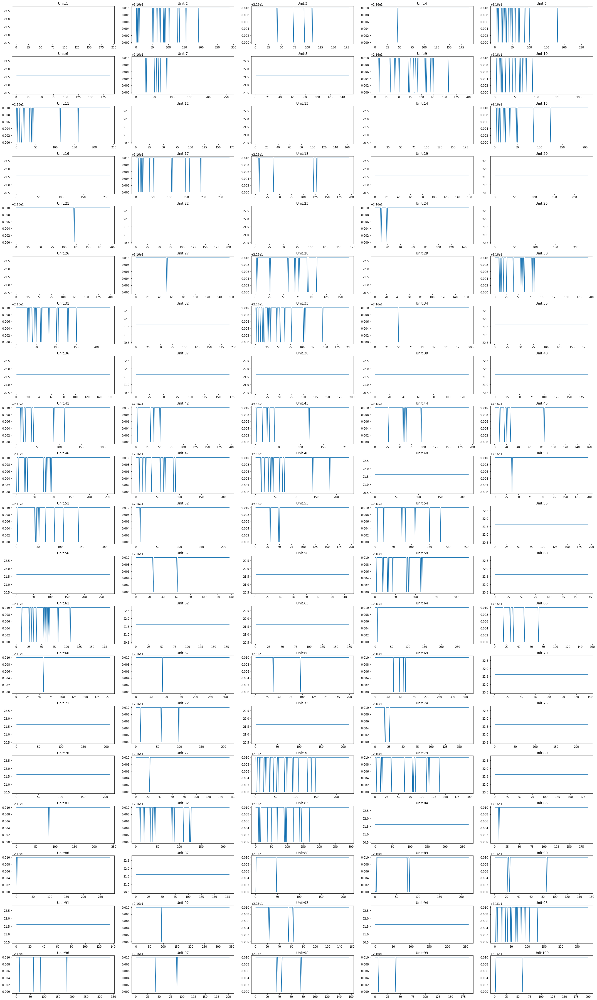

In [37]:
import seaborn as sns
fig, ax = plt.subplots(nrows = 20, ncols = 5, figsize = (30,50))

ax = ax.ravel()

for i in range(0,100):
    sns.lineplot(data = df_train_1[df_train_1.ID == i+1], x = "Cycle", y = "sensor_measurement_6", ax = ax[i])
    ax[i].set_title("Unit:" + str(i+1))
    ax[i].set_xlabel("")
    ax[i].set_ylabel("")

plt.tight_layout()

We see that in case of sensor measurement 6 the standard deviation is pretty close to zero, and these cases are mostly constant values with sudden peaks, so no information will be extracted from this sensor in the modelling, discard

In [38]:
df_train_1.drop(columns=columns_to_delete, axis=1, inplace=True)
df_train_1

,ID,Cycle,operarional_setting_1,operarional_setting_2,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_7,sensor_measurement_8,sensor_measurement_9,sensor_measurement_11,sensor_measurement_12,sensor_measurement_13,sensor_measurement_14,sensor_measurement_15,sensor_measurement_17,sensor_measurement_20,sensor_measurement_21,RUL
0,1,1,-0.0007,-0.0004,641.82,1589.70,1400.60,554.36,2388.06,9046.19,47.47,521.66,2388.02,8138.62,8.4195,392,39.06,23.4190,191
1,1,2,0.0019,-0.0003,642.15,1591.82,1403.14,553.75,2388.04,9044.07,47.49,522.28,2388.07,8131.49,8.4318,392,39.00,23.4236,190
2,1,3,-0.0043,0.0003,642.35,1587.99,1404.20,554.26,2388.08,9052.94,47.27,522.42,2388.03,8133.23,8.4178,390,38.95,23.3442,189
3,1,4,0.0007,0.0000,642.35,1582.79,1401.87,554.45,2388.11,9049.48,47.13,522.86,2388.08,8133.83,8.3682,392,38.88,23.3739,188
4,1,5,-0.0019,-0.0002,642.37,1582.85,1406.22,554.00,2388.06,9055.15,47.28,522.19,2388.04,8133.80,8.4294,393,38.90,23.4044,187
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,100,196,-0.0004,-0.0003,643.49,1597.98,1428.63,551.43,2388.19,9065.52,48.07,519.49,2388.26,8137.60,8.4956,397,38.49,22.9735,4
20627,100,197,-0.0016,-0.0005,643.54,1604.50,1433.58,550.86,2388.23,9065.11,48.04,519.68,2388.22,8136.50,8.5139,395,38.30,23.1594,3
20628,100,198,0.0004,0.0000,643.42,1602.46,1428.18,550.94,2388.24,9065.90,48.09,520.01,2388.24,8141.05,8.5646,398,38.44,22.9333,2
20629,100,199,-0.0011,0.0003,643.23,1605.26,1426.53,550.68,2388.25,9073.72,48.39,519.67,2388.23,8139.29,8.5389,395,38.29,23.0640,1


<AxesSubplot:>

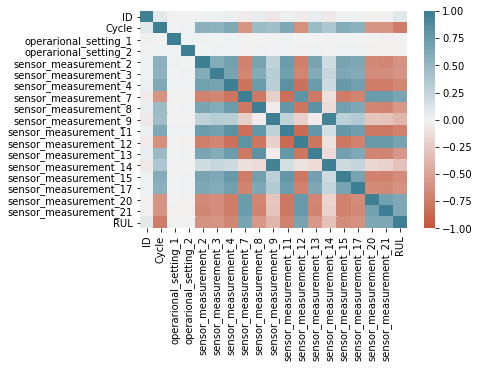

In [39]:
corr_matrix = df_train_1.corr()
sns.heatmap(corr_matrix, vmin=-1,vmax=1,center=0, cmap=sns.diverging_palette(20,220,n=200))

In [40]:
corr_matrix.style.background_gradient(cmap='coolwarm', vmin=-1, vmax=1,)

,ID,Cycle,operarional_setting_1,operarional_setting_2,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_7,sensor_measurement_8,sensor_measurement_9,sensor_measurement_11,sensor_measurement_12,sensor_measurement_13,sensor_measurement_14,sensor_measurement_15,sensor_measurement_17,sensor_measurement_20,sensor_measurement_21,RUL
ID,1.000000,0.078753,-0.017895,-0.006197,0.014133,0.012621,0.026116,-0.032073,0.039929,-0.052053,0.024707,-0.031882,0.044230,-0.059473,0.022486,0.013513,-0.020589,-0.016465,0.078753
Cycle,0.078753,1.000000,-0.004527,0.016132,0.549898,0.543947,0.624577,-0.595914,0.475977,0.443999,0.634385,-0.611354,0.477523,0.370324,0.588676,0.566995,-0.583597,-0.585923,-0.736241
operarional_setting_1,-0.017895,-0.004527,1.000000,0.011660,0.009030,-0.005651,0.009544,-0.009437,-0.000427,-0.004279,0.011658,-0.001491,0.002318,-0.004469,0.007652,0.002599,-0.005713,-0.014559,-0.003198
operarional_setting_2,-0.006197,0.016132,0.011660,1.000000,0.007266,0.009068,0.014673,-0.016678,0.013285,-0.005425,0.011690,-0.010923,0.018156,-0.006310,0.014156,0.012280,-0.010554,-0.007846,-0.001948
sensor_measurement_2,0.014133,0.549898,0.009030,0.007266,1.000000,0.602610,0.714949,-0.702136,0.662325,0.273764,0.740020,-0.724578,0.661792,0.179752,0.675975,0.629886,-0.661841,-0.668050,-0.606484
sensor_measurement_3,0.012621,0.543947,-0.005651,0.009068,0.602610,1.000000,0.678413,-0.664595,0.602481,0.322964,0.695900,-0.680307,0.600963,0.237137,0.639921,0.600017,-0.625941,-0.633901,-0.584520
sensor_measurement_4,0.026116,0.624577,0.009544,0.014673,0.714949,0.678413,1.000000,-0.793130,0.746852,0.297429,0.830136,-0.815591,0.745158,0.190748,0.758459,0.703499,-0.748067,-0.745193,-0.678948
sensor_measurement_7,-0.032073,-0.595914,-0.009437,-0.016678,-0.702136,-0.664595,-0.793130,1.000000,-0.767132,-0.217835,-0.822805,0.812713,-0.764611,-0.110053,-0.747051,-0.692893,0.736163,0.737447,0.657223
sensor_measurement_8,0.039929,0.475977,-0.000427,0.013285,0.662325,0.602481,0.746852,-0.767132,1.000000,-0.032091,0.782213,-0.786540,0.826084,-0.144787,0.700949,0.627785,-0.687030,-0.688840,-0.563968
sensor_measurement_9,-0.052053,0.443999,-0.004279,-0.005425,0.273764,0.322964,0.297429,-0.217835,-0.032091,1.000000,0.274591,-0.210238,-0.034763,0.963157,0.293753,0.337110,-0.285280,-0.292795,-0.390102


Let's automate finding high correlation features

In [41]:
corr_pd = pd.DataFrame(corr_matrix.values, columns=corr_matrix.columns, index=corr_matrix.index)

high_corrs_features = []
for col in corr_pd:
    col_corr = corr_pd[col]
    mask_pairs  = col_corr.apply(lambda x: abs(x)>0.9)
    idx_pairs = col_corr[mask_pairs].index
    
    for idx, corr in zip(idx_pairs, col_corr[mask_pairs].values):
        high_corrs_features.append((col, idx, corr))
repeated_items = []
for i in high_corrs_features:
    if i[2] == 1:
        repeated_items.append(i)
difference = set(high_corrs_features).symmetric_difference(set(repeated_items))
difference 

{('sensor_measurement_14', 'sensor_measurement_9', 0.9631566003059564),
 ('sensor_measurement_9', 'sensor_measurement_14', 0.9631566003059564)}

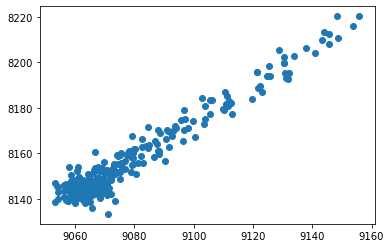

In [42]:
df_id_ = df_train_1[df_train_1["ID"]==54]
plt.scatter(df_id_['sensor_measurement_9'], df_id_['sensor_measurement_14'])
plt.show()

We may hence delete one of these two variables

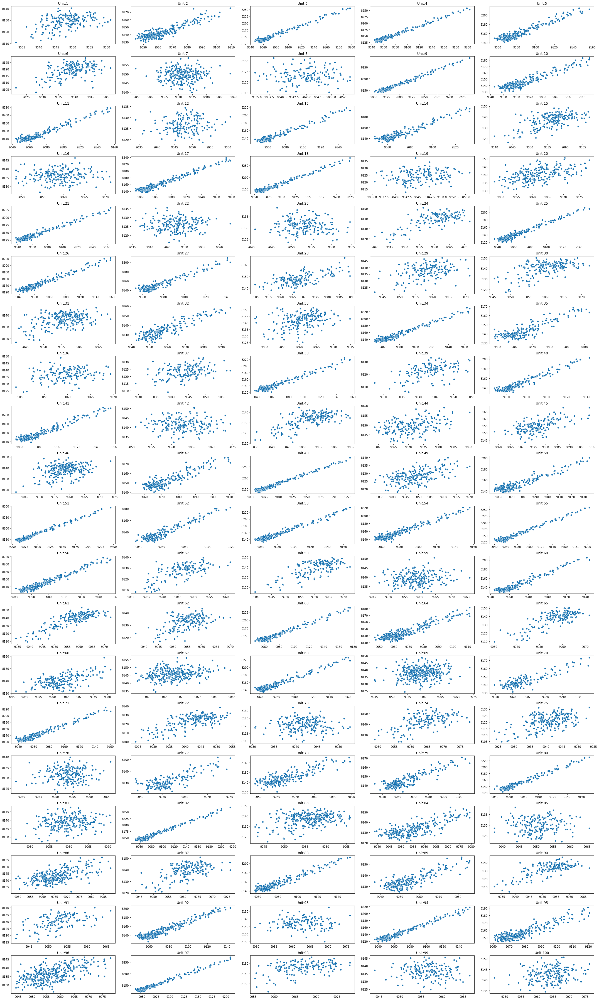

In [43]:
fig, ax = plt.subplots(nrows = 20, ncols = 5, figsize = (30,50))

ax = ax.ravel()

for i in range(0,100):
    sns.scatterplot(data = df_train_1[df_train_1.ID == i+1], x = "sensor_measurement_9", y = "sensor_measurement_14", ax = ax[i])
    ax[i].set_title("Unit:" + str(i+1))
    ax[i].set_xlabel("")
    ax[i].set_ylabel("")

plt.tight_layout()

In [44]:
df_train_1.drop(columns="sensor_measurement_14", axis=1, inplace=True)
df_train_1

,ID,Cycle,operarional_setting_1,operarional_setting_2,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_7,sensor_measurement_8,sensor_measurement_9,sensor_measurement_11,sensor_measurement_12,sensor_measurement_13,sensor_measurement_15,sensor_measurement_17,sensor_measurement_20,sensor_measurement_21,RUL
0,1,1,-0.0007,-0.0004,641.82,1589.70,1400.60,554.36,2388.06,9046.19,47.47,521.66,2388.02,8.4195,392,39.06,23.4190,191
1,1,2,0.0019,-0.0003,642.15,1591.82,1403.14,553.75,2388.04,9044.07,47.49,522.28,2388.07,8.4318,392,39.00,23.4236,190
2,1,3,-0.0043,0.0003,642.35,1587.99,1404.20,554.26,2388.08,9052.94,47.27,522.42,2388.03,8.4178,390,38.95,23.3442,189
3,1,4,0.0007,0.0000,642.35,1582.79,1401.87,554.45,2388.11,9049.48,47.13,522.86,2388.08,8.3682,392,38.88,23.3739,188
4,1,5,-0.0019,-0.0002,642.37,1582.85,1406.22,554.00,2388.06,9055.15,47.28,522.19,2388.04,8.4294,393,38.90,23.4044,187
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,100,196,-0.0004,-0.0003,643.49,1597.98,1428.63,551.43,2388.19,9065.52,48.07,519.49,2388.26,8.4956,397,38.49,22.9735,4
20627,100,197,-0.0016,-0.0005,643.54,1604.50,1433.58,550.86,2388.23,9065.11,48.04,519.68,2388.22,8.5139,395,38.30,23.1594,3
20628,100,198,0.0004,0.0000,643.42,1602.46,1428.18,550.94,2388.24,9065.90,48.09,520.01,2388.24,8.5646,398,38.44,22.9333,2
20629,100,199,-0.0011,0.0003,643.23,1605.26,1426.53,550.68,2388.25,9073.72,48.39,519.67,2388.23,8.5389,395,38.29,23.0640,1


/home/dsc/anaconda3/lib/python3.8/site-packages/pandas/core/frame.py:4163: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


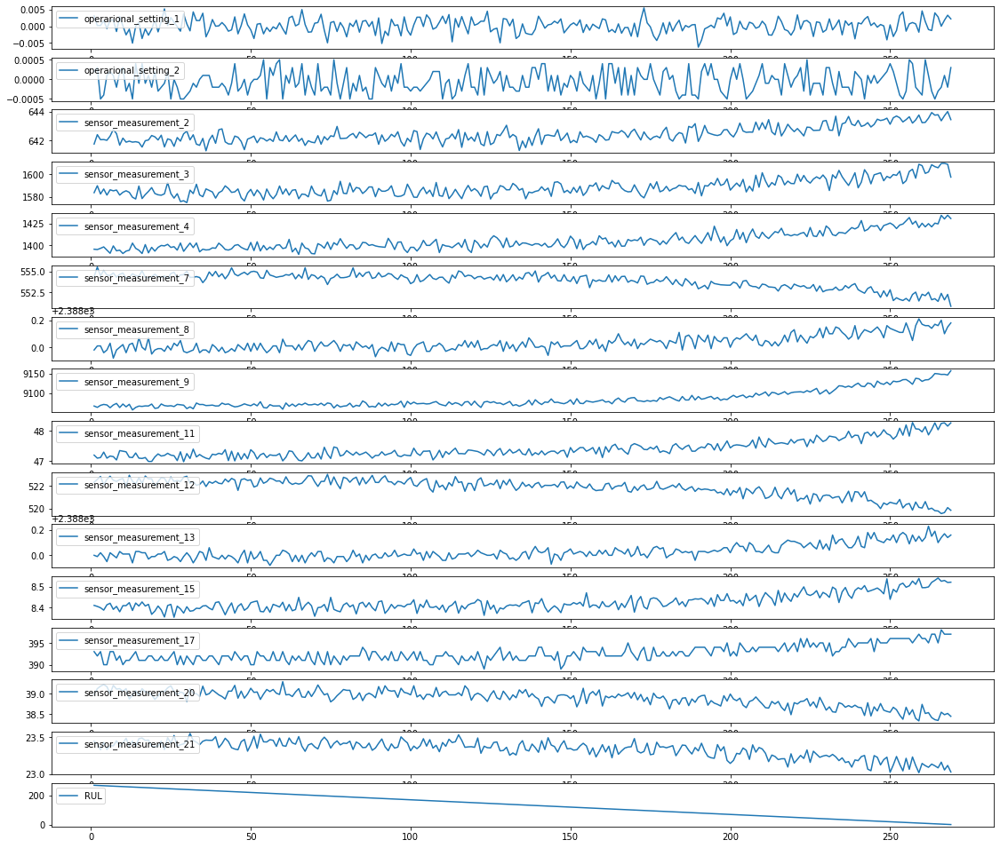

In [45]:
df_1 = df_train_1[df_train_1["ID"]==5] # df for the needed engine
time = df_1['Cycle']
df_1.drop(labels=['Cycle'],axis=1,inplace=True)
cols = df_1.columns[1:]
    
    # plotting
fig, axes = plt.subplots(len(cols), 1, figsize=(19,17))
for col, ax in zip(cols, axes):
    ax.plot(time,df_1[col],label=col)
    ax.legend(loc=2)
        
# figure title    


In [46]:
df = df_train_1[df_train_1["ID"]<20]

Let's plot the remaining features and see their evolution

<AxesSubplot:title={'center':'sensor_measurement_21'}, xlabel='Cycle'>

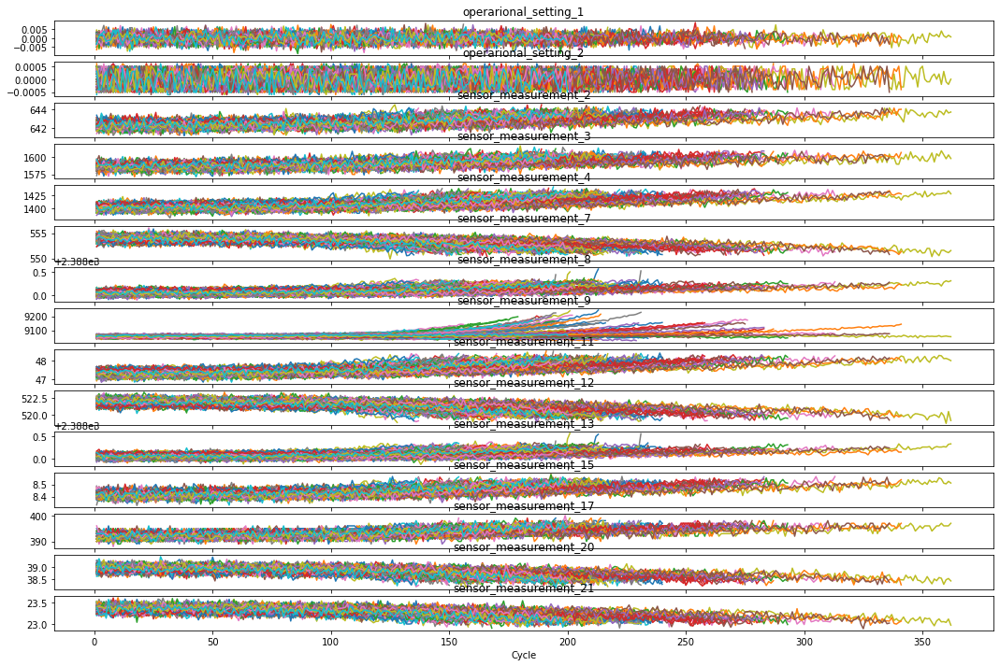

In [47]:
df_1 = df_train_1[["ID","Cycle","operarional_setting_1"]]
df_2 = df_train_1[["ID","Cycle","operarional_setting_2"]]
df_3 = df_train_1[["ID","Cycle","sensor_measurement_2"]]
df_4 = df_train_1[["ID","Cycle","sensor_measurement_3"]]
df_5 = df_train_1[["ID","Cycle","sensor_measurement_4"]]
df_6 = df_train_1[["ID","Cycle","sensor_measurement_7"]]
df_7 = df_train_1[["ID","Cycle","sensor_measurement_8"]]
df_8 = df_train_1[["ID","Cycle","sensor_measurement_9"]]
df_9 = df_train_1[["ID","Cycle","sensor_measurement_11"]]
df_10 = df_train_1[["ID","Cycle","sensor_measurement_12"]]
df_11 = df_train_1[["ID","Cycle","sensor_measurement_13"]]
df_12 = df_train_1[["ID","Cycle","sensor_measurement_15"]]
df_13 = df_train_1[["ID","Cycle","sensor_measurement_17"]]
df_14 = df_train_1[["ID","Cycle","sensor_measurement_20"]]
df_15 = df_train_1[["ID","Cycle","sensor_measurement_21"]]


df_1 = df_1.pivot(index='Cycle', columns='ID', values='operarional_setting_1')
df_2 = df_2.pivot(index='Cycle', columns='ID', values='operarional_setting_2')
df_3 = df_3.pivot(index='Cycle', columns='ID', values='sensor_measurement_2')
df_4 = df_4.pivot(index='Cycle', columns='ID', values='sensor_measurement_3')
df_5 = df_5.pivot(index='Cycle', columns='ID', values='sensor_measurement_4')
df_6 = df_6.pivot(index='Cycle', columns='ID', values='sensor_measurement_7')
df_7 = df_7.pivot(index='Cycle', columns='ID', values='sensor_measurement_8')
df_8 = df_8.pivot(index='Cycle', columns='ID', values='sensor_measurement_9')
df_9 = df_9.pivot(index='Cycle', columns='ID', values='sensor_measurement_11')
df_10 = df_10.pivot(index='Cycle', columns='ID', values='sensor_measurement_12')
df_11 = df_11.pivot(index='Cycle', columns='ID', values='sensor_measurement_13')
df_12 = df_12.pivot(index='Cycle', columns='ID', values='sensor_measurement_15')
df_13 = df_13.pivot(index='Cycle', columns='ID', values='sensor_measurement_17')
df_14 = df_14.pivot(index='Cycle', columns='ID', values='sensor_measurement_20')
df_15 = df_15.pivot(index='Cycle', columns='ID', values='sensor_measurement_21')

fig, axes = plt.subplots(nrows=15, ncols=1, figsize=(18,12))

df_1.plot(ax=axes[0],legend=None, title="operarional_setting_1")
df_2.plot(ax=axes[1],legend=None, title="operarional_setting_2")
df_3.plot(ax=axes[2],legend=None, title="sensor_measurement_2")
df_4.plot(ax=axes[3],legend=None, title="sensor_measurement_3")
df_5.plot(ax=axes[4],legend=None, title="sensor_measurement_4")
df_6.plot(ax=axes[5],legend=None, title="sensor_measurement_7")
df_7.plot(ax=axes[6],legend=None, title="sensor_measurement_8")
df_8.plot(ax=axes[7],legend=None, title="sensor_measurement_9")
df_9.plot(ax=axes[8],legend=None, title="sensor_measurement_11")
df_10.plot(ax=axes[9],legend=None, title="sensor_measurement_12")
df_11.plot(ax=axes[10],legend=None, title="sensor_measurement_13")
df_12.plot(ax=axes[11],legend=None, title="sensor_measurement_15")
df_13.plot(ax=axes[12],legend=None, title="sensor_measurement_17")
df_14.plot(ax=axes[13],legend=None, title="sensor_measurement_20")
df_15.plot(ax=axes[14],legend=None, title="sensor_measurement_21")

#### Start predictions with Linear Regression

In [48]:
df_train_1

,ID,Cycle,operarional_setting_1,operarional_setting_2,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_7,sensor_measurement_8,sensor_measurement_9,sensor_measurement_11,sensor_measurement_12,sensor_measurement_13,sensor_measurement_15,sensor_measurement_17,sensor_measurement_20,sensor_measurement_21,RUL
0,1,1,-0.0007,-0.0004,641.82,1589.70,1400.60,554.36,2388.06,9046.19,47.47,521.66,2388.02,8.4195,392,39.06,23.4190,191
1,1,2,0.0019,-0.0003,642.15,1591.82,1403.14,553.75,2388.04,9044.07,47.49,522.28,2388.07,8.4318,392,39.00,23.4236,190
2,1,3,-0.0043,0.0003,642.35,1587.99,1404.20,554.26,2388.08,9052.94,47.27,522.42,2388.03,8.4178,390,38.95,23.3442,189
3,1,4,0.0007,0.0000,642.35,1582.79,1401.87,554.45,2388.11,9049.48,47.13,522.86,2388.08,8.3682,392,38.88,23.3739,188
4,1,5,-0.0019,-0.0002,642.37,1582.85,1406.22,554.00,2388.06,9055.15,47.28,522.19,2388.04,8.4294,393,38.90,23.4044,187
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,100,196,-0.0004,-0.0003,643.49,1597.98,1428.63,551.43,2388.19,9065.52,48.07,519.49,2388.26,8.4956,397,38.49,22.9735,4
20627,100,197,-0.0016,-0.0005,643.54,1604.50,1433.58,550.86,2388.23,9065.11,48.04,519.68,2388.22,8.5139,395,38.30,23.1594,3
20628,100,198,0.0004,0.0000,643.42,1602.46,1428.18,550.94,2388.24,9065.90,48.09,520.01,2388.24,8.5646,398,38.44,22.9333,2
20629,100,199,-0.0011,0.0003,643.23,1605.26,1426.53,550.68,2388.25,9073.72,48.39,519.67,2388.23,8.5389,395,38.29,23.0640,1


In [49]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import *

We bring to the notebook the test set as well as the real values of the RUL which we'll use to evaluate our model

In [50]:
df_test_1 = pd.read_csv('/home/dsc/Downloads/CMAPSSData/test_FD001.txt', sep=" ", header=None)
list_units_1 = 3
operational_list = []
for n in range(1,list_units_1+1):
    operational = "operarional_setting_" + str(n)
    operational_list.append(operational)

list_units_2 = 23
sensor_measurement_list = []
for n in range(1,list_units_2+1):
    sensor = "sensor_measurement_" + str(n)
    sensor_measurement_list.append(sensor)

df_test_1.columns = ["ID", "Cycle"] + operational_list + sensor_measurement_list
df_test_1 = df_test_1.dropna(axis=1)
df_test_1.drop(columns="operarional_setting_3",axis=1, inplace=True)
df_test_1.drop(columns=columns_to_delete, axis=1, inplace=True)
df_test_1.drop(columns="sensor_measurement_14", axis=1, inplace=True)

df_test_1

,ID,Cycle,operarional_setting_1,operarional_setting_2,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_7,sensor_measurement_8,sensor_measurement_9,sensor_measurement_11,sensor_measurement_12,sensor_measurement_13,sensor_measurement_15,sensor_measurement_17,sensor_measurement_20,sensor_measurement_21
0,1,1,0.0023,0.0003,643.02,1585.29,1398.21,553.90,2388.04,9050.17,47.20,521.72,2388.03,8.4052,392,38.86,23.3735
1,1,2,-0.0027,-0.0003,641.71,1588.45,1395.42,554.85,2388.01,9054.42,47.50,522.16,2388.06,8.3803,393,39.02,23.3916
2,1,3,0.0003,0.0001,642.46,1586.94,1401.34,554.11,2388.05,9056.96,47.50,521.97,2388.03,8.4441,393,39.08,23.4166
3,1,4,0.0042,0.0000,642.44,1584.12,1406.42,554.07,2388.03,9045.29,47.28,521.38,2388.05,8.3917,391,39.00,23.3737
4,1,5,0.0014,0.0000,642.51,1587.19,1401.92,554.16,2388.01,9044.55,47.31,522.15,2388.03,8.4031,390,38.99,23.4130
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13091,100,194,0.0049,0.0000,643.24,1599.45,1415.79,553.41,2388.02,9142.37,47.69,520.69,2388.00,8.4715,394,38.65,23.1974
13092,100,195,-0.0011,-0.0001,643.22,1595.69,1422.05,553.22,2388.05,9140.68,47.60,521.05,2388.09,8.4512,395,38.57,23.2771
13093,100,196,-0.0006,-0.0003,643.44,1593.15,1406.82,553.04,2388.11,9146.81,47.57,521.18,2388.04,8.4569,395,38.62,23.2051
13094,100,197,-0.0038,0.0001,643.26,1594.99,1419.36,553.37,2388.07,9148.85,47.61,521.33,2388.08,8.4711,395,38.66,23.2699


In [51]:
df_rul_1 = pd.read_csv('/home/dsc/Downloads/CMAPSSData/RUL_FD001.txt', sep=" ", header=None)


df_rul_1.dropna(axis=1,inplace=True)
df_rul_1.columns = ["RUL"]
df_rul_1

,RUL
0,112
1,98
2,69
3,82
4,91
...,...
95,137
96,82
97,59
98,117


We now prepare the datasets to feed the model.

1. First, we prepare the training dataset, which consists on the X_train containing the feature columns and the y_train with the target labels
2. Secondly, we get the testset to introduce the last information available for the test engine collection, and aggrgates the real RUL for this testset as the real target label

In [52]:
X_train = df_train_1.drop(columns=["ID","Cycle","RUL"], axis=1)
y_train = df_train_1["RUL"]

df_test_1_red = df_test_1.groupby("ID").last().reset_index()
X_test = df_test_1_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_rul_1

In [53]:
X_train.shape, y_train.shape, X_test.shape, y_test.shape

((20631, 15), (20631,), (100, 15), (100, 1))

Import the Linear Regression model, and fit with the training dataset

In [54]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import *
lr = LinearRegression()
lr.fit(X_train, y_train)

LinearRegression()

Once the model has been trained with these data, we predict the values to check their similarity with real ones, first with train data and then with test data

Training Score:

In [55]:
preds_y_train = lr.predict(X_train)
print("TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train,preds_y_train), "\n",
      "MSE: ", mean_squared_error(y_train, preds_y_train), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train, preds_y_train)), "\n",
      "R2 score: ", r2_score(y_train, preds_y_train))

TRAIN SCORES - - - -  
 MAE:  27.68539128917473 
 MSE:  1996.6093360146433 
 RMSE:  44.68343469357121 
 R2 score:  0.5791615760470866


Test Score:

In [56]:
preds_y_test = lr.predict(X_test)
print("TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, preds_y_test), "\n",
      "MSE: ", mean_squared_error(y_test, preds_y_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, preds_y_test)), "\n",
      "R2 score: ", r2_score(y_test, preds_y_test))

TEST SCORES - - - -  
 MAE:  20.35089466845966 
 MSE:  1042.805696052291 
 RMSE:  32.2925021646247 
 R2 score:  0.3961294494660793


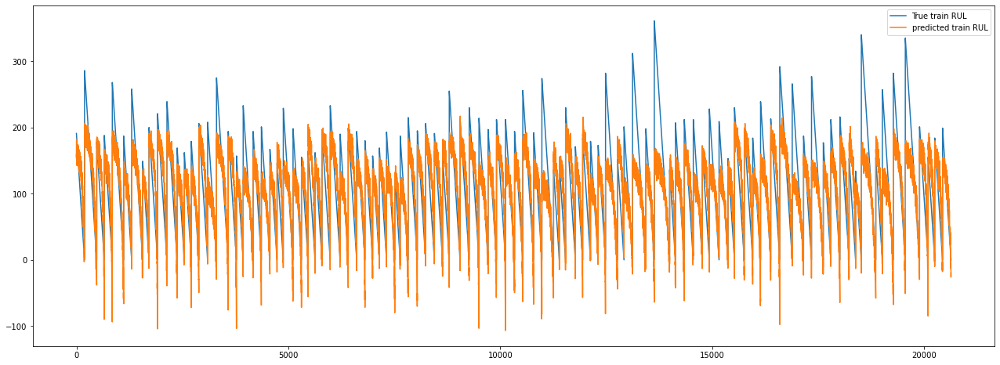

In [57]:
plt.figure(figsize = (22, 8))

plt.plot(y_train, label="True train RUL")
plt.plot(preds_y_train, label="predicted train RUL")
plt.legend()
plt.show()

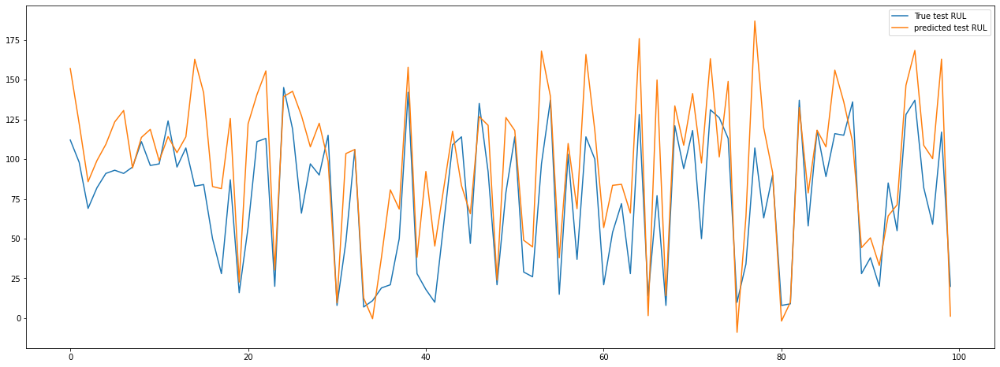

In [58]:
plt.figure(figsize = (22, 8))

plt.plot(y_test, label="True test RUL")
plt.plot(preds_y_test, label="predicted test RUL")
plt.legend()
plt.show()

Let's now try with a more sophisticated model: 
#### Random Forest Regressor

In [59]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import RandomizedSearchCV


n_estimators = [int(x) for x in np.linspace(start = 10, stop = 100, num = 10)]
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]

random_grid = {'n_estimators': n_estimators,
               'max_depth': max_depth}
print(random_grid)

{'n_estimators': [10, 20, 30, 40, 50, 60, 70, 80, 90, 100], 'max_depth': [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, 110]}


In [60]:
regr = RandomForestRegressor()
rf_random = RandomizedSearchCV(estimator=regr, param_distributions=random_grid, random_state=42)
rf_random.fit(X_train, y_train)

RandomizedSearchCV(estimator=RandomForestRegressor(),
                   param_distributions={'max_depth': [10, 20, 30, 40, 50, 60,
                                                      70, 80, 90, 100, 110],
                                        'n_estimators': [10, 20, 30, 40, 50, 60,
                                                         70, 80, 90, 100]},
                   random_state=42)

In [61]:
rf_random.best_params_

In [85]:
hyper_regr = RandomForestRegressor(n_estimators=50, max_depth=10)
hyper_regr.fit(X_train, y_train)

RandomForestRegressor(max_depth=10, n_estimators=50)

In [86]:
rul_train_pred_rf = hyper_regr.predict(X_train)
print("RANDOM FOREST TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train, rul_train_pred_rf), "\n",
      "MSE: ", mean_squared_error(y_train, rul_train_pred_rf), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train, rul_train_pred_rf)), "\n",
      "R2 score: ", r2_score(y_train, rul_train_pred_rf))

RANDOM FOREST TRAIN SCORES - - - -  
 MAE:  17.0874588952216 
 MSE:  1349.6655809241263 
 RMSE:  36.73779499267922 
 R2 score:  0.7155221476258604


In [87]:
rul_test_pred_rf = hyper_regr.predict(X_test)
print("RANDOM FOREST TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, rul_test_pred_rf), "\n",
      "MSE: ", mean_squared_error(y_test, rul_test_pred_rf), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, rul_test_pred_rf)), "\n",
      "R2 score: ", r2_score(y_test, rul_test_pred_rf))

RANDOM FOREST TEST SCORES - - - -  
 MAE:  17.299890994674 
 MSE:  1068.8804329220477 
 RMSE:  32.693736906662224 
 R2 score:  0.38103002512636275


In [65]:
plt.figure(figsize = (22, 8))

plt.plot(y_train, label="True test RUL")
plt.plot(rul_train_pred_rf, label="predicted test RUL")
plt.legend()
plt.show()

In [66]:
plt.figure(figsize = (22, 8))

plt.plot(y_test, label="True test RUL")
plt.plot(rul_test_pred_rf, label="predicted test RUL")
plt.legend()
plt.show()

In [ ]:
hdiwc

### SVR

In [89]:
from sklearn.svm import SVR
svr = SVR(kernel="linear")

In [88]:
X_train

,operarional_setting_1,operarional_setting_2,sensor_measurement_2,sensor_measurement_3,sensor_measurement_4,sensor_measurement_7,sensor_measurement_8,sensor_measurement_9,sensor_measurement_11,sensor_measurement_12,sensor_measurement_13,sensor_measurement_15,sensor_measurement_17,sensor_measurement_20,sensor_measurement_21
0,-0.0007,-0.0004,641.82,1589.70,1400.60,554.36,2388.06,9046.19,47.47,521.66,2388.02,8.4195,392,39.06,23.4190
1,0.0019,-0.0003,642.15,1591.82,1403.14,553.75,2388.04,9044.07,47.49,522.28,2388.07,8.4318,392,39.00,23.4236
2,-0.0043,0.0003,642.35,1587.99,1404.20,554.26,2388.08,9052.94,47.27,522.42,2388.03,8.4178,390,38.95,23.3442
3,0.0007,0.0000,642.35,1582.79,1401.87,554.45,2388.11,9049.48,47.13,522.86,2388.08,8.3682,392,38.88,23.3739
4,-0.0019,-0.0002,642.37,1582.85,1406.22,554.00,2388.06,9055.15,47.28,522.19,2388.04,8.4294,393,38.90,23.4044
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,-0.0004,-0.0003,643.49,1597.98,1428.63,551.43,2388.19,9065.52,48.07,519.49,2388.26,8.4956,397,38.49,22.9735
20627,-0.0016,-0.0005,643.54,1604.50,1433.58,550.86,2388.23,9065.11,48.04,519.68,2388.22,8.5139,395,38.30,23.1594
20628,0.0004,0.0000,643.42,1602.46,1428.18,550.94,2388.24,9065.90,48.09,520.01,2388.24,8.5646,398,38.44,22.9333
20629,-0.0011,0.0003,643.23,1605.26,1426.53,550.68,2388.25,9073.72,48.39,519.67,2388.23,8.5389,395,38.29,23.0640


In [90]:
X_train = df_train_1.drop(columns=["ID","Cycle","RUL"], axis=1)
y_train = df_train_1["RUL"]

df_test_1_red = df_test_1.groupby("ID").last().reset_index()
X_test = df_test_1_red.drop(columns=["ID","Cycle"], axis=1)
y_test = df_rul_1

svr.fit(X_train, y_train)
preds_train_svr = svr.predict(X_train)

In [69]:
print("SVR TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train, preds_train_svr), "\n",
      "MSE: ", mean_squared_error(y_train, preds_train_svr), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train, preds_train_svr)), "\n",
      "R2 score: ", r2_score(y_train, preds_train_svr))

SVR TRAIN SCORES - - - -  
 MAE:  27.00705636021121 
 MSE:  2102.8598535682886 
 RMSE:  45.856949893863295 
 R2 score:  0.5567664587124608


In [70]:
preds_test_svr = svr.predict(X_test)
print("SVR TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, preds_test_svr), "\n",
      "MSE: ", mean_squared_error(y_test, preds_test_svr), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, preds_test_svr)), "\n",
      "R2 score: ", r2_score(y_test, preds_test_svr))

SVR TRAIN SCORES - - - -  
 MAE:  21.115561366081238 
 MSE:  973.0428965124478 
 RMSE:  31.193635512912692 
 R2 score:  0.43652786723881876


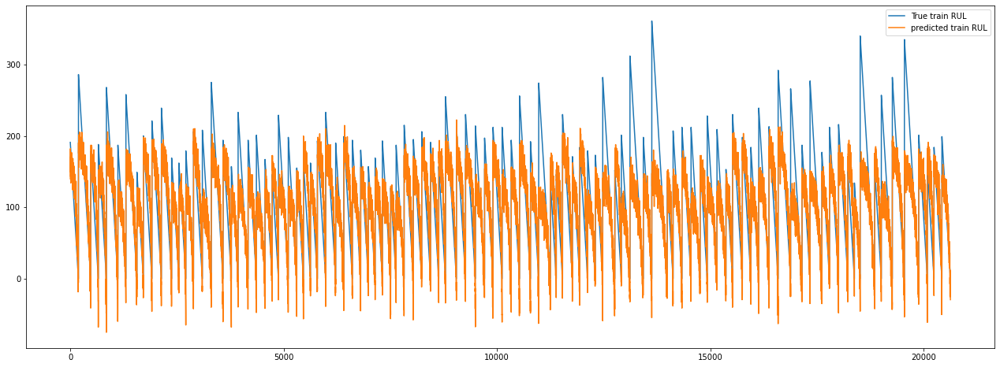

In [71]:
plt.figure(figsize = (22, 8))

plt.plot(y_train, label="True train RUL")
plt.plot(preds_train_svr, label="predicted train RUL")
plt.legend()
plt.show()

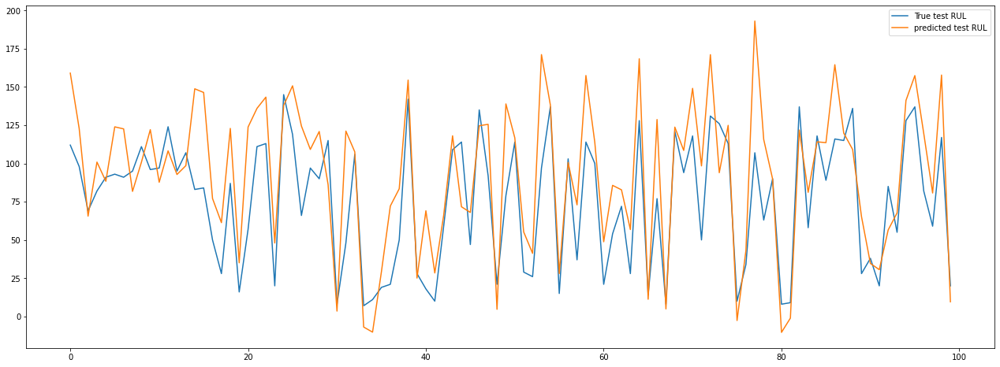

In [72]:
plt.figure(figsize = (22, 8))

plt.plot(y_test, label="True test RUL")
plt.plot(preds_test_svr, label="predicted test RUL")
plt.legend()
plt.show()

Between these 3 simple models we arrive at the conclusion that the SVR brings the best accuracy to test set

We may try with further models, but we will now try to bring more information from the dataset, to check wether we can filter or modify the features to acquire better metrics

## Sensors plot linear regressions to check slope

Another way to extract information from the dataset is to check how the features change throughout the performance of the engines. If a sensor shows that the measurement varies way bigger than other, it will mean that this sensor will have a bigger impact on the remaining useful life of the engine

From previous visualizations, we've noticed that operational settings do not show engine state variation, as they do not tend to increase or decrease during the performance

/home/dsc/anaconda3/lib/python3.8/site-packages/pandas/core/frame.py:4163: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


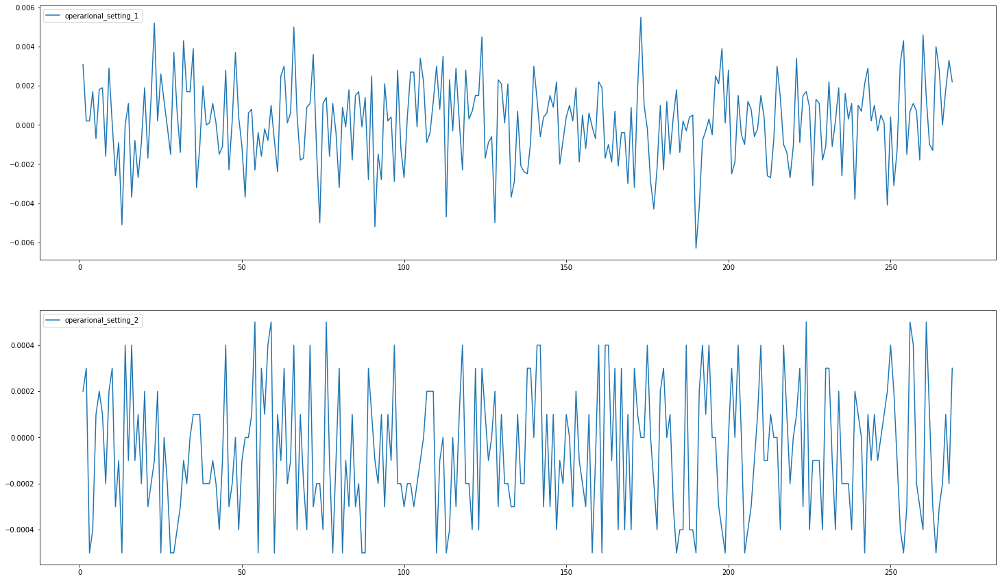

In [73]:
df_1 = df_train_1[df_train_1["ID"]==5] # df for the needed engine
cycles = df_1['Cycle']
df_1.drop(labels=['Cycle'],axis=1,inplace=True)
cols = df_1.columns[1:-1]
    
    # plotting
fig, axes = plt.subplots(2,1, figsize=(25,15))
for col, ax in zip(cols, axes):
    ax.plot(cycles,df_1[col],label=col)
    ax.legend(loc=2)

Due to this, and trying to ease computational effort of the model, these two parameters will be omitted (however, a proof to this decision is showed afterwards once the slopes per feature are calculated)

A good way to check the feature variation throughout the engine performance is to calculate the slope of its linear regression

In [74]:
df_1 = df_train_1[df_train_1["ID"]==1]
x = df_1["Cycle"].values.reshape(-1,1)
df_1.shape

(192, 18)

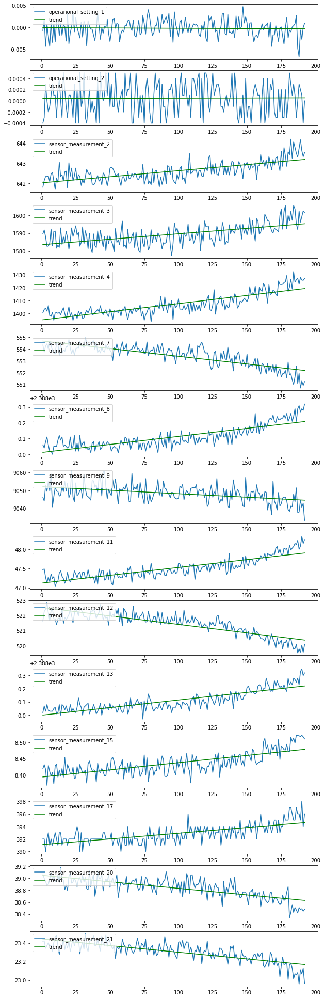

In [75]:
cols = df_1.columns[2:-1]
fig, axes = plt.subplots(len(cols), 1, figsize=(10,35))
slopes = []
for col, ax in zip(cols, axes):
    linear = LinearRegression()
    y = df_1[col].values.reshape(-1,1)
    linear.fit(x,y)
    preds = linear.predict(x)
    ax.plot(x,y, label=col)
    ax.plot(x,preds,"g",label='trend')
    ax.legend(loc=2)
    slope = linear.coef_
    slopes.append(slope)

We now can calulate this slope and sort these features by its importance

In [76]:
slopes_df = pd.DataFrame({"columns": cols, "slope":slopes})
slopes_df["slope"] = slopes_df["slope"].apply(lambda x: abs(x))
slopes_df.sort_values("slope", ascending=False)

,columns,slope
4,sensor_measurement_4,[[0.12702480298673466]]
3,sensor_measurement_3,[[0.060471085505791826]]
7,sensor_measurement_9,[[0.03909743509752311]]
12,sensor_measurement_17,[[0.01820931557388168]]
5,sensor_measurement_7,[[0.013082757439709212]]
9,sensor_measurement_12,[[0.011305585885576272]]
2,sensor_measurement_2,[[0.0060736036133792835]]
8,sensor_measurement_11,[[0.004066374142093704]]
13,sensor_measurement_20,[[0.0021933663158180323]]
14,sensor_measurement_21,[[0.0014437429638119548]]


In [77]:
top_10_features_df = slopes_df.sort_values("slope", ascending=False).head(10)
top_10_features = top_10_features_df["columns"].values.tolist()
top_10_features

['sensor_measurement_4',
 'sensor_measurement_3',
 'sensor_measurement_9',
 'sensor_measurement_17',
 'sensor_measurement_7',
 'sensor_measurement_12',
 'sensor_measurement_2',
 'sensor_measurement_11',
 'sensor_measurement_20',
 'sensor_measurement_21']

In [78]:
df_train_1_top = df_train_1[["ID", "Cycle"]+top_10_features+["RUL"]]
df_train_1_top

,ID,Cycle,sensor_measurement_4,sensor_measurement_3,sensor_measurement_9,sensor_measurement_17,sensor_measurement_7,sensor_measurement_12,sensor_measurement_2,sensor_measurement_11,sensor_measurement_20,sensor_measurement_21,RUL
0,1,1,1400.60,1589.70,9046.19,392,554.36,521.66,641.82,47.47,39.06,23.4190,191
1,1,2,1403.14,1591.82,9044.07,392,553.75,522.28,642.15,47.49,39.00,23.4236,190
2,1,3,1404.20,1587.99,9052.94,390,554.26,522.42,642.35,47.27,38.95,23.3442,189
3,1,4,1401.87,1582.79,9049.48,392,554.45,522.86,642.35,47.13,38.88,23.3739,188
4,1,5,1406.22,1582.85,9055.15,393,554.00,522.19,642.37,47.28,38.90,23.4044,187
...,...,...,...,...,...,...,...,...,...,...,...,...,...
20626,100,196,1428.63,1597.98,9065.52,397,551.43,519.49,643.49,48.07,38.49,22.9735,4
20627,100,197,1433.58,1604.50,9065.11,395,550.86,519.68,643.54,48.04,38.30,23.1594,3
20628,100,198,1428.18,1602.46,9065.90,398,550.94,520.01,643.42,48.09,38.44,22.9333,2
20629,100,199,1426.53,1605.26,9073.72,395,550.68,519.67,643.23,48.39,38.29,23.0640,1


Let's train again our model filtering by the top 10 features (by slope):

In [79]:
X_train_top = df_train_1_top.drop(columns=["ID","Cycle","RUL"], axis=1)
y_train_top = df_train_1_top["RUL"]

df_test_1_top = df_test_1[["ID", "Cycle"]+top_10_features]
df_test_1_red = df_test_1_top.groupby("ID").last().reset_index()
X_test_top = df_test_1_red.drop(columns=["ID","Cycle",], axis=1)
y_test = df_rul_1

### Linear Regression

In [80]:
lr = LinearRegression()
lr.fit(X_train_top, y_train_top)

LinearRegression()

In [81]:
preds_y_train = lr.predict(X_train_top)
print("LR top10 features TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_top,preds_y_train), "\n",
      "MSE: ", mean_squared_error(y_train_top, preds_y_train), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_top, preds_y_train)), "\n",
      "R2 score: ", r2_score(y_train_top, preds_y_train))

LR top10 features TRAIN SCORES - - - -  
 MAE:  27.73149513243652 
 MSE:  2003.6223462859728 
 RMSE:  44.76184029154714 
 R2 score:  0.5776833979495911


In [82]:
preds_y_test = lr.predict(X_test_top)
print("LR top10 features TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test,preds_y_test), "\n",
      "MSE: ", mean_squared_error(y_test, preds_y_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, preds_y_test)), "\n",
      "R2 score: ", r2_score(y_test, preds_y_test))

LR top10 features TEST SCORES - - - -  
 MAE:  20.24248941509768 
 MSE:  1058.5571404763773 
 RMSE:  32.53547510758645 
 R2 score:  0.3870080633324152


What we see here is an increase in train accuracy, but slight decrease of test accuracy

### Random Forest

In [83]:
regr = RandomForestRegressor()
rf_random = RandomizedSearchCV(estimator=regr, param_distributions=random_grid, random_state=42)
rf_random.fit(X_train_top, y_train_top)

KeyboardInterrupt: 

In [ ]:
n_estimators = list(rf_random.best_params_.values())[0]
max_depth = list(rf_random.best_params_.values())[1]

hyper_regr = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth)
hyper_regr.fit(X_train_top, y_train_top)

In [ ]:
rul_train_pred_rf = hyper_regr.predict(X_train_top)
print("RANDOM FOREST top10 features TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_top, rul_train_pred_rf), "\n",
      "MSE: ", mean_squared_error(y_train_top, rul_train_pred_rf), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_top, rul_train_pred_rf)), "\n",
      "R2 score: ", r2_score(y_train_top, rul_train_pred_rf))

In [ ]:
rul_test_pred_rf = hyper_regr.predict(X_test_top)
print("RANDOM FOREST top10 features TEST SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, rul_test_pred_rf), "\n",
      "MSE: ", mean_squared_error(y_test, rul_test_pred_rf), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, rul_test_pred_rf)), "\n",
      "R2 score: ", r2_score(y_test, rul_test_pred_rf))

### SVR

In [ ]:
from sklearn.svm import SVR
svr = SVR(kernel="linear")

svr.fit(X_train_top, y_train_top)
preds_train_svr = svr.predict(X_train_top)

In [ ]:
print("SVR top10 features TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_top, preds_train_svr), "\n",
      "MSE: ", mean_squared_error(y_train_top, preds_train_svr), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_top, preds_train_svr)), "\n",
      "R2 score: ", r2_score(y_train_top, preds_train_svr))

In [ ]:
preds_test_svr = svr.predict(X_test_top)
print("SVR TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test, preds_test_svr), "\n",
      "MSE: ", mean_squared_error(y_test, preds_test_svr), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, preds_test_svr)), "\n",
      "R2 score: ", r2_score(y_test, preds_test_svr))

## Increasing number of top features used

From 1 to entire number of features, train the different models to identify the maximum metrics achieved, at which number of top features used

### Linear Regression

In [ ]:
columns = slopes_df.sort_values("slope", ascending=False)["columns"].values.tolist()
column=[]
train_scores = []
test_scores = []
for col in columns:
    column.append(col)
    #train_scores.append(r2_tr)
    #test_scores.append(r2_ts)
    df = df_train_1[["ID","Cycle"]+column]
    X_train = df.drop(columns=["ID","Cycle"], axis=1)
    
    y_train = df_train_1["RUL"]
    df_test = df_test_1[["ID", "Cycle"]+column]
    df_test_red = df_test.groupby("ID").last().reset_index()
    X_test = df_test_red.drop(columns=["ID","Cycle"], axis=1)
    y_test = df_rul_1
    
    lr = LinearRegression()
    lr.fit(X_train, y_train)
    
    preds_train = lr.predict(X_train)
    r2_tr = r2_score(y_train, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} top features: ".format(len(column)), r2_score(y_train, preds_train))
    
    preds_test = lr.predict(X_test)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} top features: ".format(len(column)), r2_score(y_test, preds_test))

In [ ]:
plt.plot(range(0,len(column)),train_scores,label="train scores")
plt.plot(range(0,len(column)), test_scores, label="test scores")
plt.legend()
mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} features out of 15".format(mx_idx))

What we see here is that filtering by features' slopes is not efficient in terms of accuracy

### Clip RUL values

During the analysis of the variables, it has come to the knowledge that the sensor measurements do not vary linearly with the decrease of RUL during all their performance. Actually, it comes a moment when the failure appears and, then, the observable variation might be seen

In case of the operational settings, it is unobservable

But let's check a random sensor (12) and see closer how its variation gets more prone once it is somewhat advanced

In [ ]:
df_train_1[df_train_1['ID']==10].shape[0]

In [ ]:
df_10 = df_train_1[df_train_1['ID']==20]
cols = df_10.columns[4:-1]

fig, axes = plt.subplots(len(cols), 1, figsize=(10,35))

for col, ax in zip(cols, axes):

    ax.plot(df_10["RUL"], df_10[col])
    plt.xlim(df_10["RUL"].iloc[0],0)
    ax2 = ax.twinx()
    ax2.plot(df_10["RUL"], df_10["RUL"], "r")
    
    ax.set_ylabel('{}'.format(col), labelpad=20)
    ax.set_xlabel('RUL', labelpad=20)
    ax2.set_ylabel('RUL', labelpad=20)

    ax.plot(df_10["RUL"], np.full(df_10.shape[0],df_10[col].iloc[0]), "g")
    

What we extract from this is that, checking the variation of the sensor measurements compared with the first lecture, it is (for most of the sensors) began to noticed an important decrease (or increase) of the lectures once the failure appears, and not from the very beginning.

This point may vary from one sensor to another, but we might point out that this RUL cycle is around 125-100 remaining cycles

What will be represented with the upper clip will be this:

In [ ]:
rul_clipped = df_10["RUL"].clip(upper=125)

In [ ]:
fig, axes = plt.subplots(len(cols), 1, figsize=(10,35))

for col, ax in zip(cols, axes):

    ax.plot(df_10["RUL"], df_10[col])
    plt.xlim(df_10["RUL"].iloc[0],0)
    ax2 = ax.twinx()
    ax2.plot(df_10["RUL"], rul_clipped, "r")
    
    ax.set_ylabel('{}'.format(col), labelpad=20)
    ax.set_xlabel('RUL', labelpad=20)
    ax2.set_ylabel('RUL', labelpad=20)

    #ax.plot(df_10["RUL"], np.full(df_10.shape[0],df_10[col].iloc[0]), "g")
    

In [ ]:
X_train = df_train_1.drop(columns=["ID","Cycle","RUL","operarional_setting_1","operarional_setting_2"], axis=1)
y_train_clip = df_train_1["RUL"].clip(upper=125)

df_test_1_red = df_test_1.groupby("ID").last().reset_index()
X_test = df_test_1_red.drop(columns=["ID","Cycle","operarional_setting_1","operarional_setting_2"], axis=1)
y_test = df_rul_1

lr = LinearRegression()
lr.fit(X_train, y_train_clip)

In [ ]:
preds_train_clip = lr.predict(X_train)
print("TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_clip,preds_train_clip), "\n",
      "MSE: ", mean_squared_error(y_train_clip, preds_train_clip), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_clip, preds_train_clip)), "\n",
      "R2 score: ", r2_score(y_train_clip, preds_train_clip))

In [ ]:
preds_test = lr.predict(X_test)
print("TRAIN SCORES - - - - ", "\n",
    "MAE: ", median_absolute_error(y_test,preds_test), "\n",
      "MSE: ", mean_squared_error(y_test, preds_test), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, preds_test)), "\n",
      "R2 score: ", r2_score(y_test, preds_test))

Success!! 
1. It seems initially constant RUL correlates better with the initially constant mean sensor signal
2. Lower peak values for RUL result in lower spread of our target variable, making it easier to fit a line
3. Consequently, this change allows our regression model to more accurately predict low RUL values, which are often more interesting/critical to predict correctly.

In [ ]:
clips = np.arange(100,170,5).tolist()
train_scores = []
test_scores = []
for clip in clips:
    X_train = df_train_1.drop(columns=["ID","Cycle","RUL","operarional_setting_1","operarional_setting_2"], axis=1)
    y_train_clip = df_train_1["RUL"].clip(upper=clip)

    df_test_1_red = df_test_1.groupby("ID").last().reset_index()
    X_test = df_test_1_red.drop(columns=["ID","Cycle","operarional_setting_1","operarional_setting_2"], axis=1)
    y_test = df_rul_1

    lr = LinearRegression()
    lr.fit(X_train, y_train_clip)
    preds_train = lr.predict(X_train)
    r2_tr = r2_score(y_train_clip, preds_train)
    train_scores.append(r2_tr)
    print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, preds_train))
    
    preds_test = lr.predict(X_test)
    r2_ts = r2_score(y_test, preds_test)
    test_scores.append(r2_ts)
    print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_test, preds_test))

In [ ]:
plt.plot(range(0,len(clips)),train_scores,label="train scores")
plt.plot(range(0,len(clips)), test_scores, label="test scores")
plt.legend()
mx_test = max(test_scores)
mx_idx = test_scores.index(mx_test)
train_mx_test = train_scores[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} upper clipped RUL".format(clip))

### SVR

In [ ]:
clips = np.arange(100,150,5).tolist()
train_scores_svr = []
test_scores_svr = []
for clip in clips:
    X_train = df_train_1.drop(columns=["ID","Cycle","RUL","operarional_setting_1","operarional_setting_2"], axis=1)
    y_train_clip = df_train_1["RUL"].clip(upper=clip)

    df_test_1_red = df_test_1.groupby("ID").last().reset_index()
    X_test = df_test_1_red.drop(columns=["ID","Cycle","operarional_setting_1","operarional_setting_2"], axis=1)
    y_test = df_rul_1

    svr = SVR(kernel="linear")
    svr.fit(X_train, y_train_clip)
    preds_train_svr = svr.predict(X_train)
    r2_tr = r2_score(y_train_clip, preds_train_svr)
    train_scores_svr.append(r2_tr)
    print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, preds_train_svr))
    
    preds_test_svr = svr.predict(X_test)
    r2_ts = r2_score(y_test, preds_test_svr)
    test_scores_svr.append(r2_ts)
    print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_test, preds_test_svr))

In [ ]:
plt.plot(range(0,len(clips)),train_scores_svr,label="train scores")
plt.plot(range(0,len(clips)), test_scores_svr, label="test scores")
plt.legend()
mx_test = max(test_scores_svr)
mx_idx = test_scores_svr.index(mx_test)
train_mx_test = train_scores_svr[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} upper clipped RUL".format(clip))

Weird results...

SVRs work by comparing distances between feature vectors. But when features vary in range, the calculated distance gets dominated by the one which has bigger range. Let’s say one feature ranges between 10–11 and another between 1000–1100. They both vary 10% but the latter has a much larger absolute difference. Changes in its range will be weighed much more heavily by the SVR.
To account for this problem, you can scale your features to have them all within the same range. This allows your SVRs to compare the relative distances and have variations approximately weighed equally

## MinMaxScaler

In [ ]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()

X_train = df_train_1.drop(columns=["ID","Cycle","RUL","operarional_setting_1","operarional_setting_2"], axis=1)
y_train_clip = df_train_1["RUL"].clip(upper=145)
df_test_1_red = df_test_1.groupby("ID").last().reset_index()
X_test = df_test_1_red.drop(columns=["ID","Cycle","operarional_setting_1","operarional_setting_2"], axis=1)
y_test = df_rul_1

scaler.fit(X_train)
X_train_scal = scaler.transform(X_train)
X_test_scal = scaler.transform(X_test)

svr = SVR(kernel="linear")
svr.fit(X_train_scal, y_train_clip)

In [ ]:
preds_train_scal = svr.predict(X_train_scal)
print("TRAIN SCORES SVR clipped 145 MinMaxScaled- - - - ", "\n",
    "MAE: ", median_absolute_error(y_train_clip,preds_train_scal), "\n",
      "MSE: ", mean_squared_error(y_train_clip, preds_train_scal), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_train_clip, preds_train_scal)), "\n",
      "R2 score: ", r2_score(y_train_clip, preds_train_scal))

In [ ]:
preds_test_scal = svr.predict(X_test_scal)
print("TRAIN SCORES SVR clipped 145 MinMaxScaled- - - - ", "\n",
    "MAE: ", median_absolute_error(y_test,preds_test_scal), "\n",
      "MSE: ", mean_squared_error(y_test, preds_test_scal), "\n",
      "RMSE: ",np.sqrt(mean_squared_error(y_test, preds_test_scal)), "\n",
      "R2 score: ", r2_score(y_test, preds_test_scal))

SVR with several clips together with MinMaxScaler

In [ ]:
clips = np.arange(100,150,5).tolist()
train_scores_svr = []
test_scores_svr = []
for clip in clips:
    scaler = MinMaxScaler()
    X_train = df_train_1.drop(columns=["ID","Cycle","RUL","operarional_setting_1","operarional_setting_2"], axis=1)
    y_train_clip = df_train_1["RUL"].clip(upper=clip)

    df_test_1_red = df_test_1.groupby("ID").last().reset_index()
    X_test = df_test_1_red.drop(columns=["ID","Cycle","operarional_setting_1","operarional_setting_2"], axis=1)
    y_test = df_rul_1
    
    scaler.fit(X_train)
    X_train_scal = scaler.transform(X_train)
    X_test_scal = scaler.transform(X_test)

    svr = SVR(kernel="linear")
    svr.fit(X_train_scal, y_train_clip)
    preds_train_svr = svr.predict(X_train_scal)
    r2_tr = r2_score(y_train_clip, preds_train_svr)
    train_scores_svr.append(r2_tr)
    print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, preds_train_svr))
    
    preds_test_svr = svr.predict(X_test_scal)
    r2_ts = r2_score(y_test, preds_test_svr)
    test_scores_svr.append(r2_ts)
    print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_test, preds_test_svr))

In [ ]:
plt.plot(range(0,len(clips)),train_scores_svr,label="train scores")
plt.plot(range(0,len(clips)), test_scores_svr, label="test scores")
plt.legend()
mx_test = max(test_scores_svr)
mx_idx = test_scores_svr.index(mx_test)
train_mx_test = train_scores_svr[mx_idx]
print("Train Score from max Test Score: ", train_mx_test, "\n",
      "Max Test Score: ", mx_test, "\n",
     "Achieved with {} upper clipped RUL".format(clip))

### RF with clip RUL

In [ ]:
X_train = df_train_1.drop(columns=["ID","Cycle","RUL","operarional_setting_1","operarional_setting_2"], axis=1)
y_train_clip = df_train_1["RUL"].clip(upper=125)

df_test_1_red = df_test_1.groupby("ID").last().reset_index()
X_test = df_test_1_red.drop(columns=["ID","Cycle","operarional_setting_1","operarional_setting_2"], axis=1)
y_test = df_rul_1

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import RandomizedSearchCV


n_estimators = [int(x) for x in np.linspace(start = 10, stop = 100, num = 10)]
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]

random_grid = {'n_estimators': n_estimators,
                'max_depth': max_depth}
print(random_grid)

In [ ]:
# regr = RandomForestRegressor()
# rf_random_clip = RandomizedSearchCV(estimator=regr, param_distributions=random_grid, random_state=42)
# rf_random_clip.fit(X_train, y_train_clip)

In [ ]:
# rf_random_clip.best_params_

In [ ]:
# n_estimators = list(rf_random_clip.best_params_.values())[0]
# max_depth = list(rf_random_clip.best_params_.values())[1]

In [ ]:
# hyper_regr = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth)
# hyper_regr.fit(X_train, y_train_clip)

In [ ]:
# rul_train_pred_rf = hyper_regr.predict(X_train)
# print("RANDOM FOREST TRAIN SCORES - - - - ", "\n",
#      "MAE: ", median_absolute_error(y_train_clip, rul_train_pred_rf), "\n",
#        "MSE: ", mean_squared_error(y_train_clip, rul_train_pred_rf), "\n",
#        "RMSE: ",np.sqrt(mean_squared_error(y_train_clip, rul_train_pred_rf)), "\n",
#        "R2 score: ", r2_score(y_train_clip, rul_train_pred_rf))

In [ ]:
# rul_test_pred_rf = hyper_regr.predict(X_test)
# print("RANDOM FOREST TEST SCORES - - - - ", "\n",
#      "MAE: ", median_absolute_error(y_test, rul_test_pred_rf), "\n",
#        "MSE: ", mean_squared_error(y_test, rul_test_pred_rf), "\n",
#        "RMSE: ",np.sqrt(mean_squared_error(y_test, rul_test_pred_rf)), "\n",
#        "R2 score: ", r2_score(y_test, rul_test_pred_rf))

In [ ]:
# clips = np.arange(100,150,10).tolist()
# train_scores_rf = []
# test_scores_rf = []
# for clip in clips:
#     X_train = df_train_1.drop(columns=["ID","Cycle","RUL","operarional_setting_1","operarional_setting_2"], axis=1)
#     y_train_clip = df_train_1["RUL"].clip(upper=clip)

#     df_test_1_red = df_test_1.groupby("ID").last().reset_index()
#     X_test = df_test_1_red.drop(columns=["ID","Cycle","operarional_setting_1","operarional_setting_2"], axis=1)
#     y_test = df_rul_1
    
#     scaler.fit(X_train)
#     X_train_scal = scaler.transform(X_train)
#     X_test_scal = scaler.transform(X_test)
    
#     regr = RandomForestRegressor()
#     rf_random_clip = RandomizedSearchCV(estimator=regr, param_distributions=random_grid, random_state=42)
#     rf_random_clip.fit(X_train_scal, y_train_clip)
#     n_estimators = list(rf_random_clip.best_params_.values())[0]
#     max_depth = list(rf_random_clip.best_params_.values())[1]
#     hyper_regr = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth)
#     hyper_regr.fit(X_train_scal, y_train_clip)
#     rul_train_pred_rf = hyper_regr.predict(X_train_scal)
#     r2_tr = r2_score(y_train_clip, rul_train_pred_rf)
#     train_scores_rf.append(r2_tr)
#     print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, rul_train_pred_rf))
    
#     rul_test_pred_rf = hyper_regr.predict(X_test)
#     r2_ts = r2_score(y_test, rul_test_pred_rf)
#     test_scores_rf.append(r2_ts)
#     print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_test, rul_test_pred_rf))

In [ ]:
# plt.plot(range(0,len(clips)),train_scores_rf,label="train scores")
# plt.plot(range(0,len(clips)), test_scores_rf, label="test scores")
# plt.legend()
# mx_test = max(test_scores_rf)
# mx_idx = test_scores_rf.index(mx_test)
# train_mx_test = train_scores_rf[mx_idx]
# print("Train Score from max Test Score: ", train_mx_test, "\n",
#       "Max Test Score: ", mx_test, "\n",
#      "Achieved with {} upper clipped RUL".format(clip))

In [ ]:
# clips = np.arange(100,150,10).tolist()
# train_scores_rf = []
# test_scores_rf = []
# for clip in clips:
#     X_train = df_train_1.drop(columns=["ID","Cycle","RUL","operarional_setting_1","operarional_setting_2"], axis=1)
#     y_train_clip = df_train_1["RUL"].clip(upper=clip)

#     df_test_1_red = df_test_1.groupby("ID").last().reset_index()
#     X_test = df_test_1_red.drop(columns=["ID","Cycle","operarional_setting_1","operarional_setting_2"], axis=1)
#     y_test = df_rul_1
    
#     scaler.fit(X_train)
#     X_train_scal = scaler.transform(X_train)
#     X_test_scal = scaler.transform(X_test)
#     regr = RandomForestRegressor()
    
#     rf_random_clip = RandomizedSearchCV(estimator=regr, param_distributions=random_grid, random_state=42)
#     rf_random_clip.fit(X_train_scal, y_train_clip)
#     n_estimators = list(rf_random_clip.best_params_.values())[0]
#     max_depth = list(rf_random_clip.best_params_.values())[1]
#     hyper_regr = RandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth)
#     hyper_regr.fit(X_train_scal, y_train_clip)
#     rul_train_pred_rf = hyper_regr.predict(X_train_scal)
#     r2_tr = r2_score(y_train_clip, rul_train_pred_rf)
#     train_scores_rf.append(r2_tr)
#     print(" TRAIN SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_train_clip, rul_train_pred_rf))
    
#     rul_test_pred_rf = hyper_regr.predict(X_test_scal)
#     r2_ts = r2_score(y_test, rul_test_pred_rf)
#     test_scores_rf.append(r2_ts)
#     print(" TEST SCORE WITH {} upper clipped RUL: ".format(clip), r2_score(y_test, rul_test_pred_rf))

In [ ]:
# plt.plot(range(0,len(clips)),train_scores_rf,label="train scores")
# plt.plot(range(0,len(clips)), test_scores_rf, label="test scores")
# plt.legend()
# mx_test = max(test_scores_rf)
# mx_idx = test_scores_rf.index(mx_test)
# train_mx_test = train_scores_rf[mx_idx]
# print("Train Score from max Test Score: ", train_mx_test, "\n",
#       "Max Test Score: ", mx_test, "\n",
#      "Achieved with {} upper clipped RUL".format(clip))

So far, the best kpis have been achieved using random forest regressor, together with 

# Dataset with 2 different fault classes